# Import tools

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Settings

In [2]:
import matplotlib

SMALL_SIZE = 14
MEDIUM_SIZE = 20
BIGGER_SIZE = 24

matplotlib.rcParams.update({
    'figure.titlesize': BIGGER_SIZE,
    'font.size': SMALL_SIZE, # Base font size
    'axes.labelsize': MEDIUM_SIZE, # Axis labels
    'axes.titlesize': MEDIUM_SIZE, # Title size
    'xtick.labelsize': SMALL_SIZE, # X-axis tick labels
    'ytick.labelsize': SMALL_SIZE, # Y-axis tick labels
    'legend.fontsize': SMALL_SIZE, # Legend text
})

# Functions

In [3]:
# Configuration
import os
import json
from pathlib import Path

# Test parameters (matching config.sh)
BANDWIDTHS = ['20', '50', '100', 'nolim']
DELAYS = ['10', '50', '100', 'nodelay']
RATES = [34, 35, 36, 44, 45, 46, 94, 95, 96, 104, 105, 106]
ITERATIONS = 3

# Rate mapping
RATE_MAP = {
    34: "HT20-SGI-MCS4",   35: "HT20-SGI-MCS5",   36: "HT20-SGI-MCS6",
    44: "HT20-SGI-MCS12",  45: "HT20-SGI-MCS13",  46: "HT20-SGI-MCS14",
    94: "HT40-SGI-MCS4",   95: "HT40-SGI-MCS5",   96: "HT40-SGI-MCS6",
    104: "HT40-SGI-MCS12", 105: "HT40-SGI-MCS13", 106: "HT40-SGI-MCS14"
}

# Paths
PROJECT_ROOT = Path('..').resolve()
TCPAAD_DIR = PROJECT_ROOT / 'results' / 'tcpaad' / 'raw'
DEFAULT_DIR = PROJECT_ROOT / 'results' / 'default' / 'raw'

print(f"TCP-AAD data directory: {TCPAAD_DIR}")
print(f"Default data directory: {DEFAULT_DIR}")
print(f"TCP-AAD data exists: {TCPAAD_DIR.exists()}")
print(f"Default data exists: {DEFAULT_DIR.exists()}")

TCP-AAD data directory: /mnt/windows/Users/thego/Documents/Dev/github.com/4ry1337/TCP-AAD-Tests/results/tcpaad/raw
Default data directory: /mnt/windows/Users/thego/Documents/Dev/github.com/4ry1337/TCP-AAD-Tests/results/default/raw
TCP-AAD data exists: True
Default data exists: True


In [4]:
def load_iperf_json(filepath):
    """Load and parse iperf3 JSON, extract time-series throughput in Mbps."""
    try:
        with open(filepath, 'r') as f:
            data = json.load(f)
        
        # Extract intervals data
        intervals = data.get('intervals', [])
        times = []
        throughputs = []
        
        for interval in intervals:
            if 'sum' in interval:
                # Get end time and throughput
                end_time = interval['sum'].get('end', 0)
                bits_per_second = interval['sum'].get('bits_per_second', 0)
                
                times.append(end_time)
                throughputs.append(bits_per_second / 1e6)  # Convert to Mbps
        
        return np.array(times), np.array(throughputs)
    except Exception as e:
        print(f"Error loading {filepath}: {e}")
        return None, None


def parse_filename(filename):
    """Extract rate, bandwidth, delay, iteration from filename.
    Example: rate104_bw100_delay50_iter2.json
    """
    parts = filename.replace('.json', '').split('_')
    
    rate = int(parts[0].replace('rate', ''))
    bw = parts[1].replace('bw', '')
    delay = parts[2].replace('delay', '')
    iteration = int(parts[3].replace('iter', ''))
    
    return rate, bw, delay, iteration


def load_config_data(kernel_type, rate, bw, delay):
    """Load all 3 iterations for a given configuration.
    Returns: list of (times, throughputs) tuples, one per iteration
    """
    data_dir = TCPAAD_DIR if kernel_type == 'tcpaad' else DEFAULT_DIR
    iterations_data = []
    
    for iter_num in range(1, ITERATIONS + 1):
        filename = f"rate{rate}_bw{bw}_delay{delay}_iter{iter_num}.json"
        filepath = data_dir / filename
        
        if filepath.exists():
            times, throughputs = load_iperf_json(filepath)
            if times is not None:
                iterations_data.append((times, throughputs))
            else:
                iterations_data.append((None, None))
        else:
            print(f"Missing: {filepath}")
            iterations_data.append((None, None))
    
    return iterations_data


def calculate_average(iterations_data):
    """Calculate average throughput across iterations.
    Handles iterations of different lengths by using the shortest length.
    """
    valid_data = [(t, tp) for t, tp in iterations_data if t is not None and tp is not None]
    
    if not valid_data:
        return None, None
    
    # Find minimum length
    min_length = min(len(tp) for _, tp in valid_data)
    
    # Truncate all to min length and calculate average
    truncated_throughputs = [tp[:min_length] for _, tp in valid_data]
    avg_throughput = np.mean(truncated_throughputs, axis=0)
    
    # Use times from first iteration (truncated)
    avg_times = valid_data[0][0][:min_length]
    
    return avg_times, avg_throughput

print("Helper functions loaded successfully!")

Helper functions loaded successfully!


In [5]:
def plot_comparison_subplot(ax, iterations_data, kernel_type, bw, delay, rate):
    """Plot 3 iterations + average on given axes."""
    # Colors for iterations
    colors = ['#1f77b4', '#ff7f0e', '#2ca02c']  # blue, orange, green
    
    # Plot individual iterations
    for i, (times, throughput) in enumerate(iterations_data):
        if times is not None and throughput is not None:
            ax.plot(times, throughput, color=colors[i], alpha=0.6, 
                   linewidth=1.5, label=f'Iteration {i+1}')
    
    # Calculate and plot average
    avg_times, avg_throughput = calculate_average(iterations_data)
    if avg_times is not None and avg_throughput is not None:
        ax.plot(avg_times, avg_throughput, color='black', 
               linewidth=3, label='Average')
    
    # Formatting
    ax.set_xlabel('Time (seconds)')
    ax.set_ylabel('Throughput (Mbps)')
    ax.set_title(f'{kernel_type.upper()}\nBW: {bw}, Delay: {delay}, Rate: {RATE_MAP[rate]}')
    ax.legend(loc='best')
    ax.grid(True, alpha=0.3)
    
    # Set y-axis to start from 0 for fair comparison
    ax.set_ylim(bottom=0)


def plot_config_comparison(rate, bw, delay):
    """Create side-by-side comparison plot for a configuration."""
    # Load data for both kernels
    tcpaad_data = load_config_data('tcpaad', rate, bw, delay)
    default_data = load_config_data('default', rate, bw, delay)
    
    # Create figure with 2 subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 6))
    
    # Plot TCP-AAD (left)
    plot_comparison_subplot(ax1, tcpaad_data, 'tcpaad', bw, delay, rate)
    
    # Plot Default (right)
    plot_comparison_subplot(ax2, default_data, 'default', bw, delay, rate)
    
    # Overall title
    fig.suptitle(f'Rate {rate} ({RATE_MAP[rate]}) - BW: {bw} Mbps, Delay: {delay} ms', 
                 fontsize=BIGGER_SIZE, fontweight='bold', y=1.00)
    
    plt.tight_layout()
    plt.show()

print("Plotting functions loaded successfully!")

Plotting functions loaded successfully!


# TCP-AAD vs Default Kernel Comparison

This notebook compares the performance of TCP-AAD kernel against the default kernel across all test configurations.

**Test Matrix:**
- 12 WiFi Rates: HT20/HT40 with SGI, MCS 4/5/6 and 12/13/14
- 4 Bandwidths: 20, 50, 100, nolim Mbps
- 4 Delays: 10, 50, 100, nodelay ms
- 3 Iterations per configuration

**Total:** 192 configurations × 2 kernels = 384 tests

Each plot shows:
- Blue line: Iteration 1
- Orange line: Iteration 2
- Green line: Iteration 3
- Black thick line: Average across iterations

## Rate 34: HT20-SGI-MCS4

Rate 34, BW 20, Delay 10


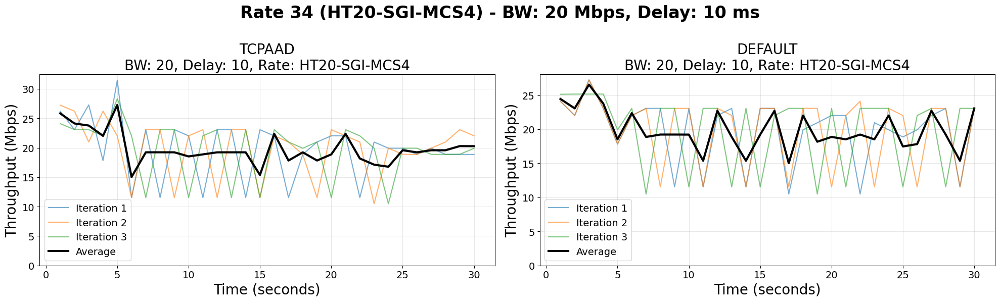

Rate 34, BW 20, Delay 50


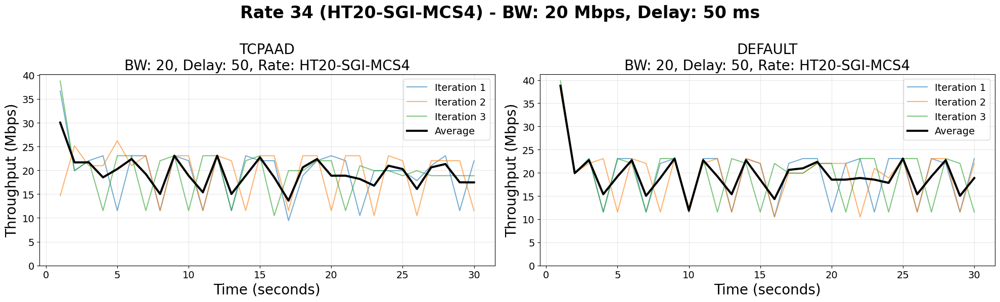

Rate 34, BW 20, Delay 100


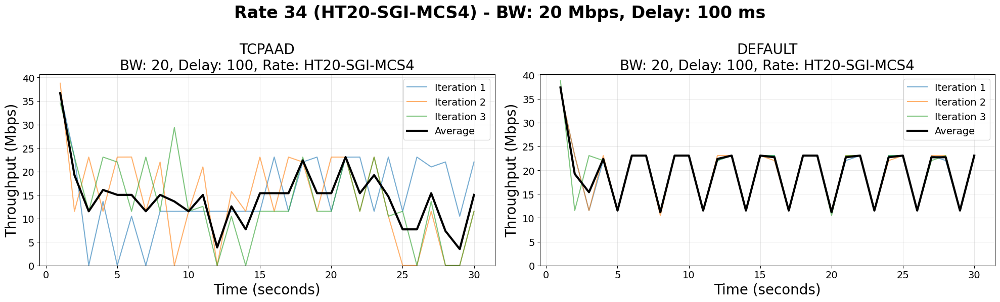

Rate 34, BW 20, Delay nodelay


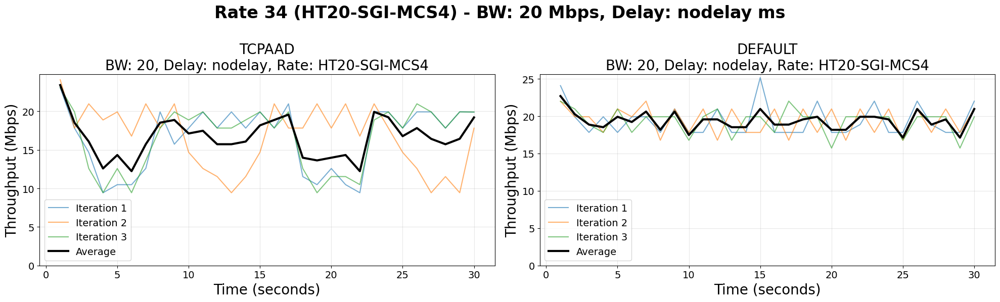

Rate 34, BW 50, Delay 10


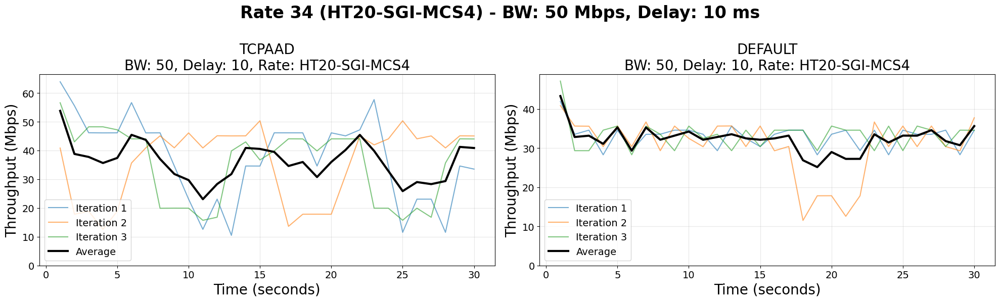

Rate 34, BW 50, Delay 50


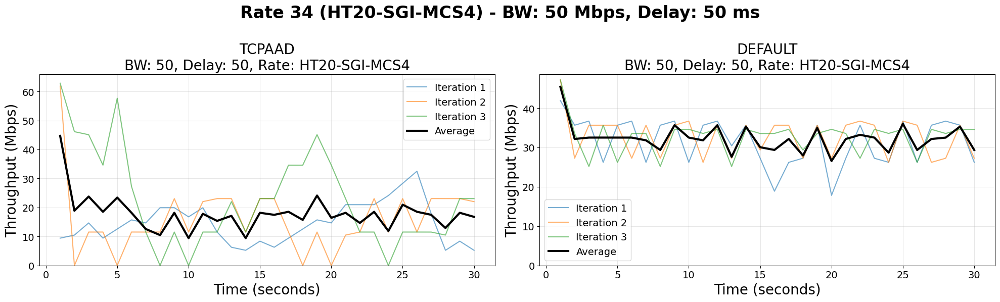

Rate 34, BW 50, Delay 100


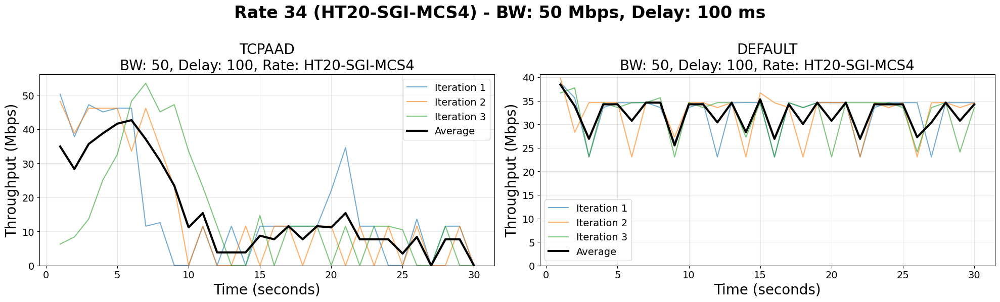

Rate 34, BW 50, Delay nodelay


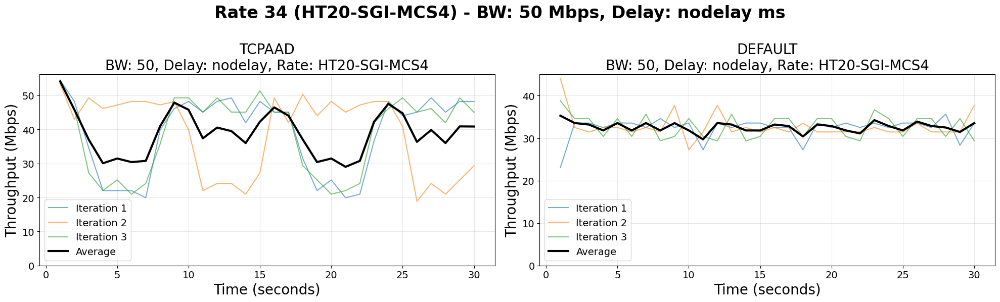

Rate 34, BW 100, Delay 10


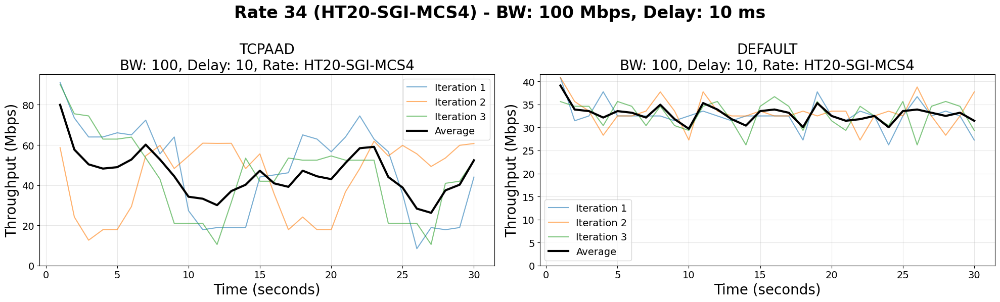

Rate 34, BW 100, Delay 50


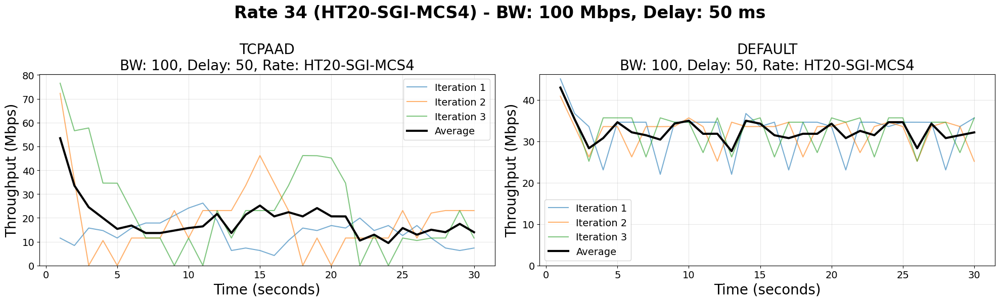

Rate 34, BW 100, Delay 100


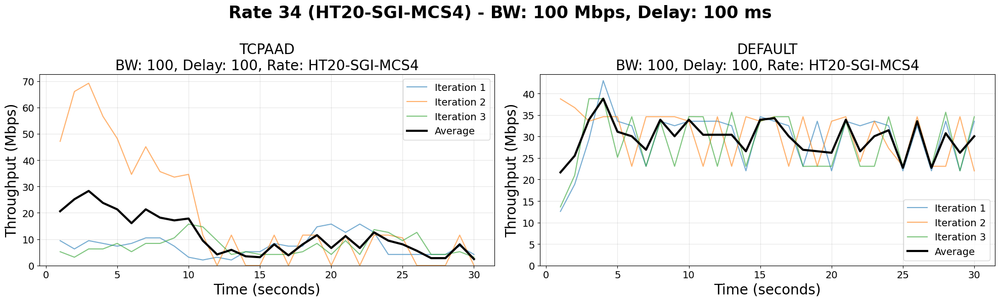

Rate 34, BW 100, Delay nodelay


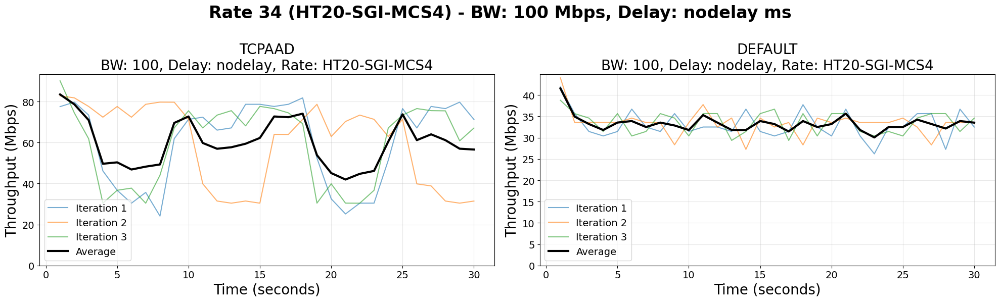

Rate 34, BW nolim, Delay 10


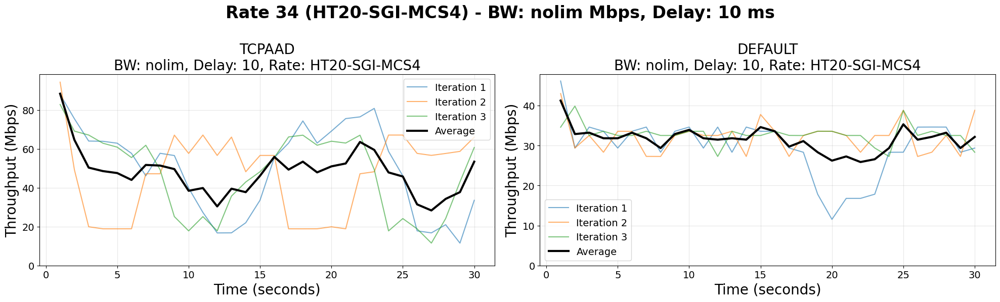

Rate 34, BW nolim, Delay 50


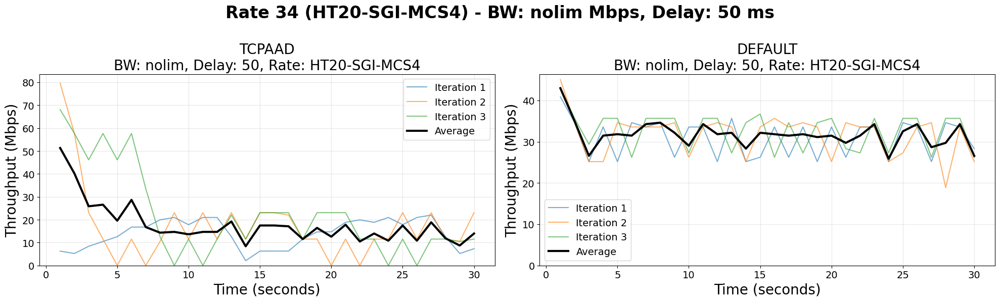

Rate 34, BW nolim, Delay 100


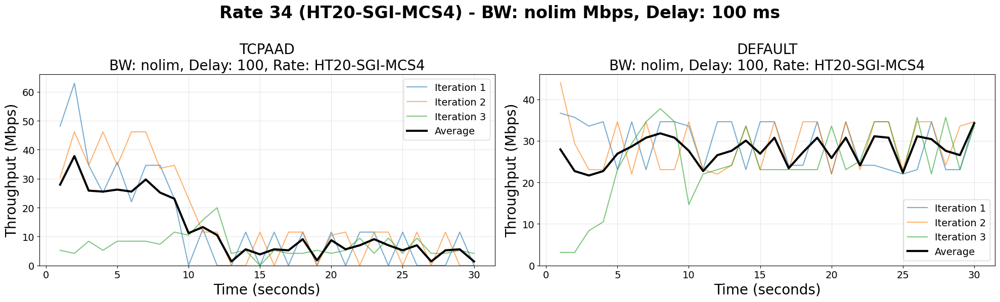

Rate 34, BW nolim, Delay nodelay


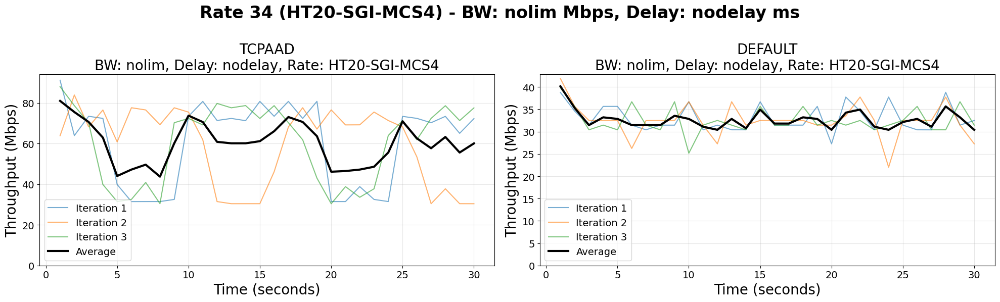

In [6]:
rate = 34
for bw in BANDWIDTHS:
    for delay in DELAYS:
        print(f"Rate {rate}, BW {bw}, Delay {delay}")
        plot_config_comparison(rate, bw, delay)

## Rate 106: HT40-SGI-MCS14

Rate 106, BW 20, Delay 10


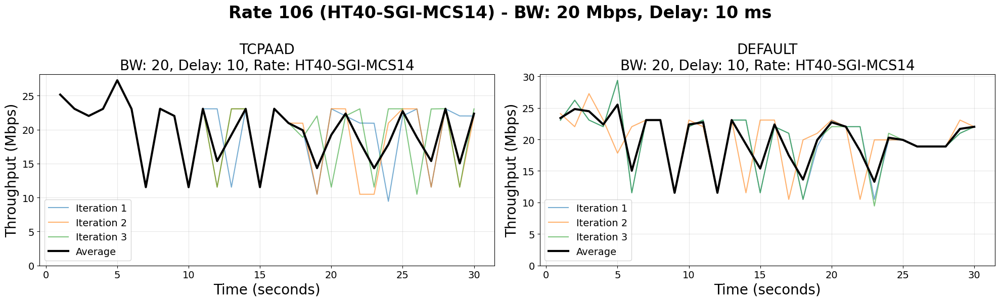

Rate 106, BW 20, Delay 50


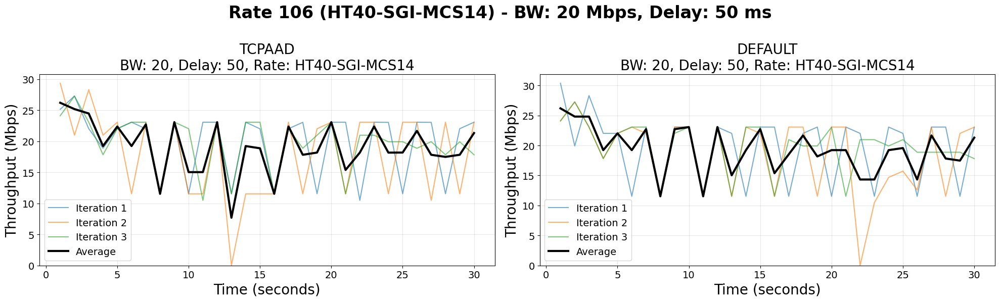

Rate 106, BW 20, Delay 100


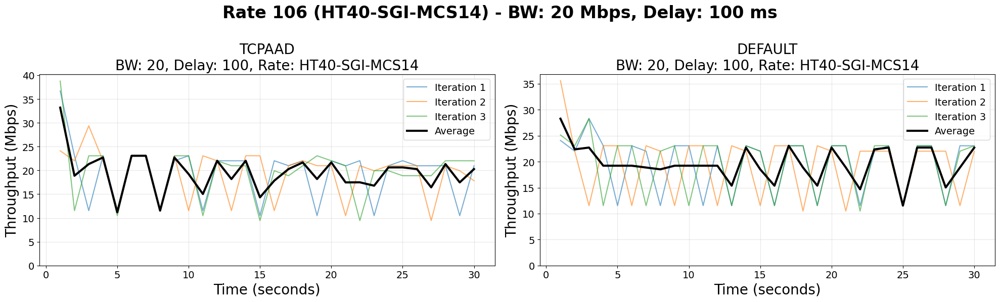

Rate 106, BW 20, Delay nodelay


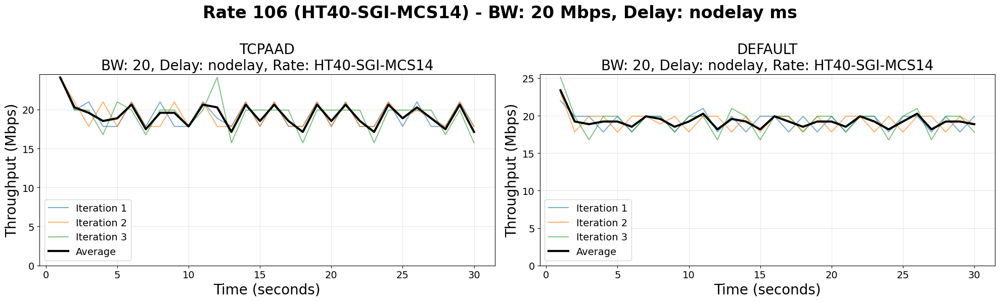

Rate 106, BW 50, Delay 10


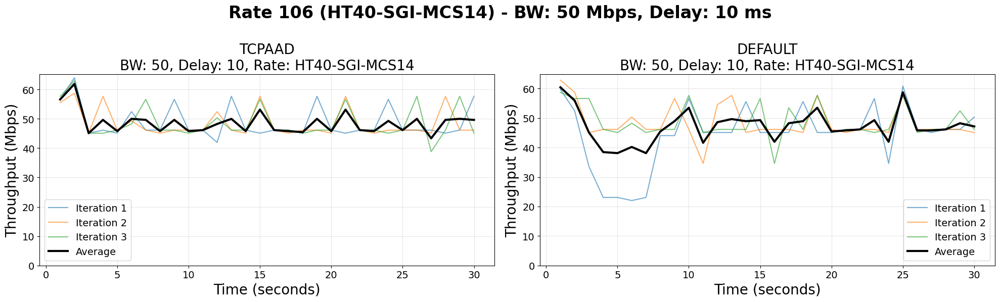

Rate 106, BW 50, Delay 50


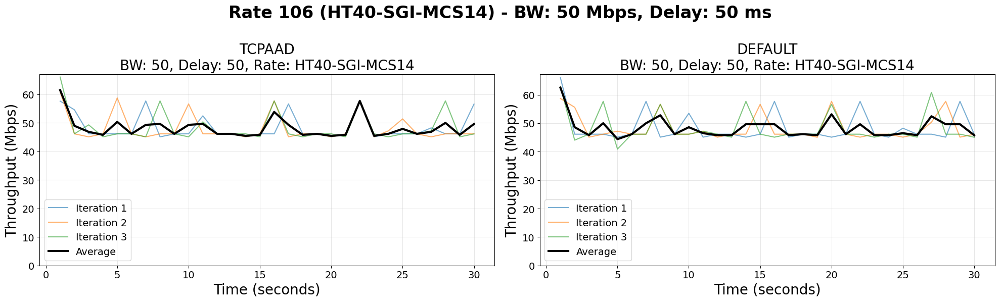

Rate 106, BW 50, Delay 100


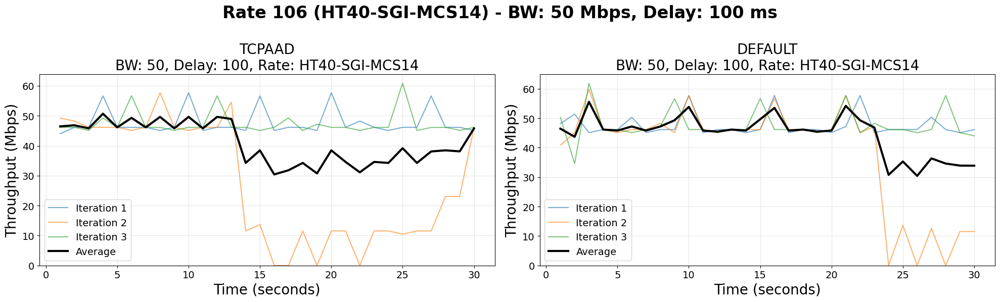

Rate 106, BW 50, Delay nodelay


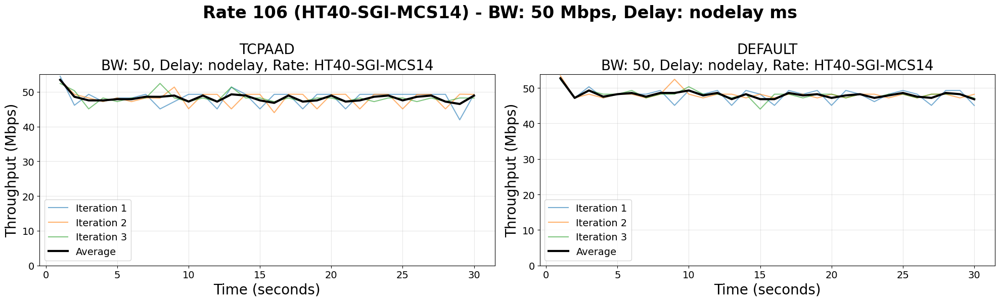

Rate 106, BW 100, Delay 10


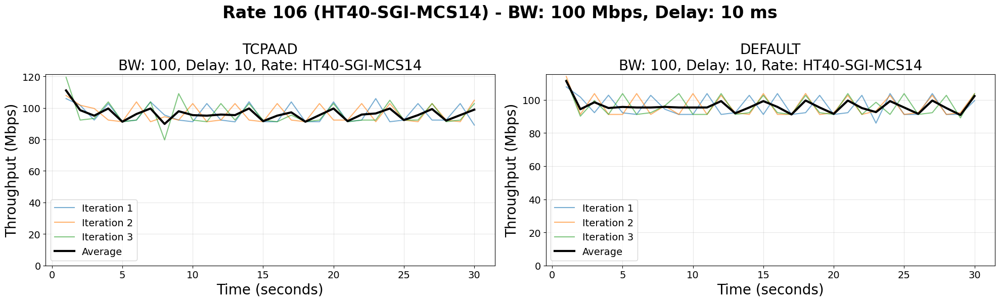

Rate 106, BW 100, Delay 50


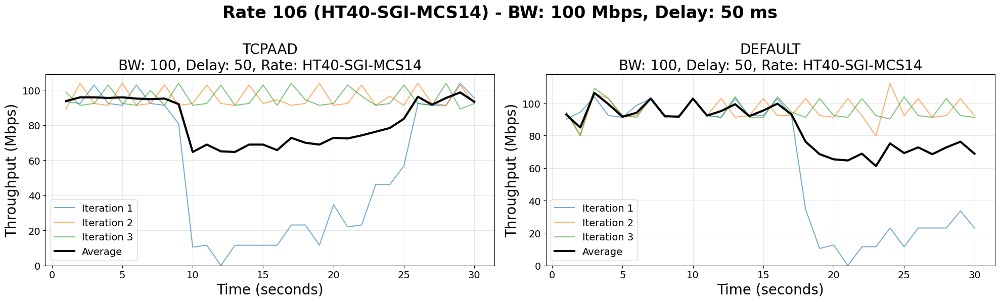

Rate 106, BW 100, Delay 100


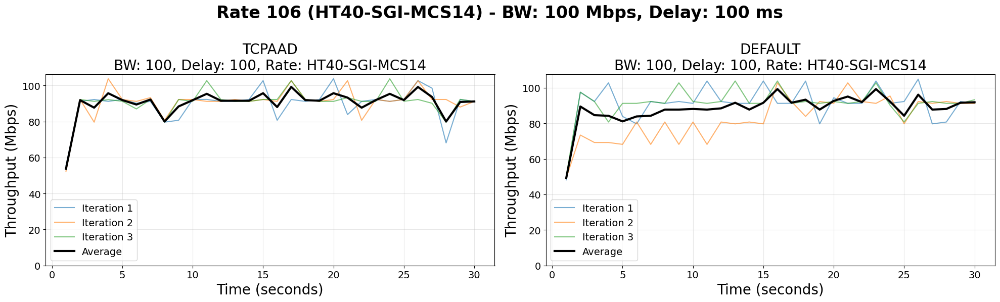

Rate 106, BW 100, Delay nodelay


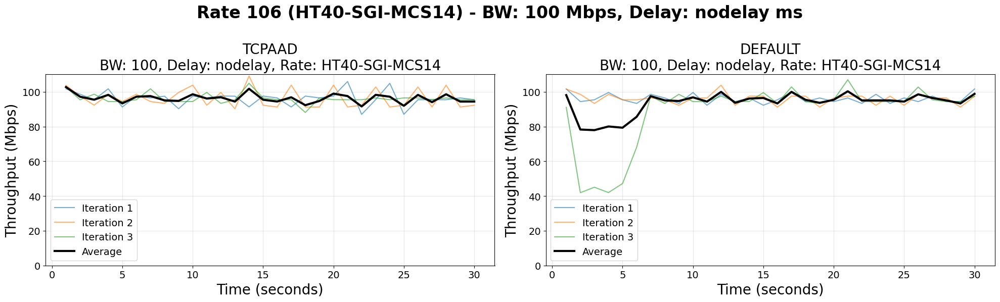

Rate 106, BW nolim, Delay 10


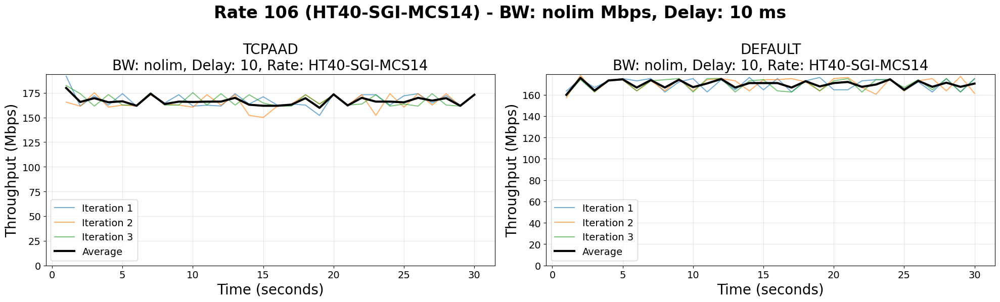

Rate 106, BW nolim, Delay 50


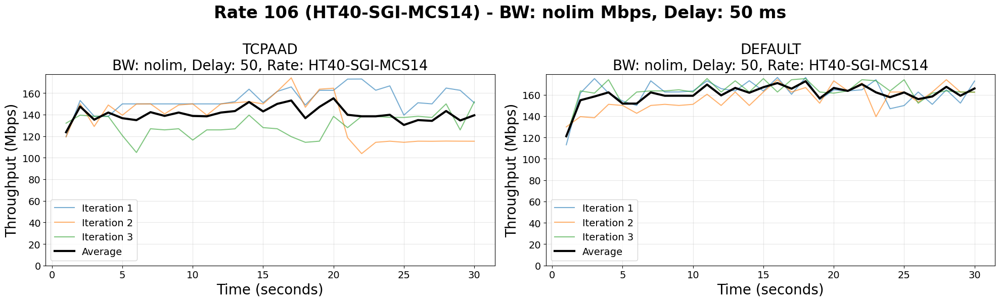

Rate 106, BW nolim, Delay 100


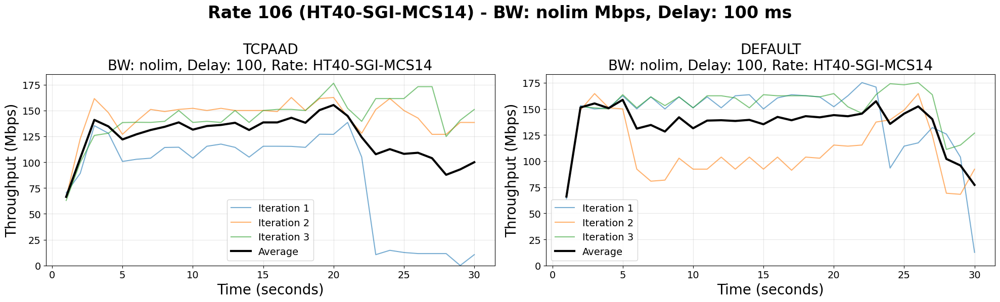

Rate 106, BW nolim, Delay nodelay


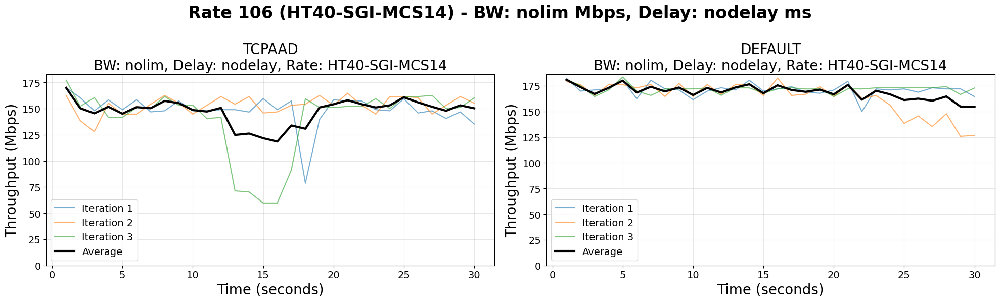

In [7]:
rate = 106
for bw in BANDWIDTHS:
    for delay in DELAYS:
        print(f"Rate {rate}, BW {bw}, Delay {delay}")
        plot_config_comparison(rate, bw, delay)

## Rate 105: HT40-SGI-MCS13

Rate 105, BW 20, Delay 10


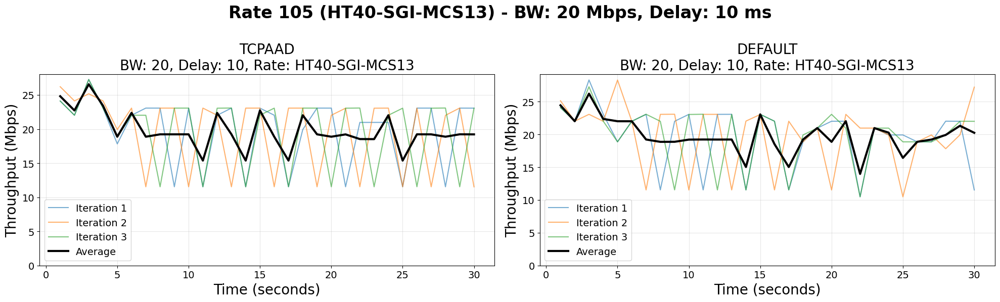

Rate 105, BW 20, Delay 50


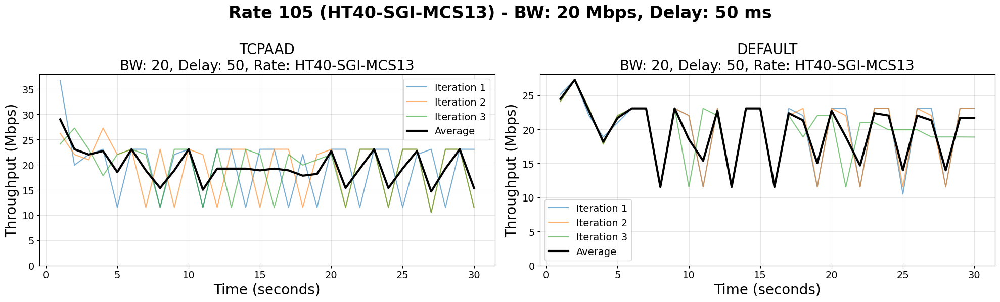

Rate 105, BW 20, Delay 100


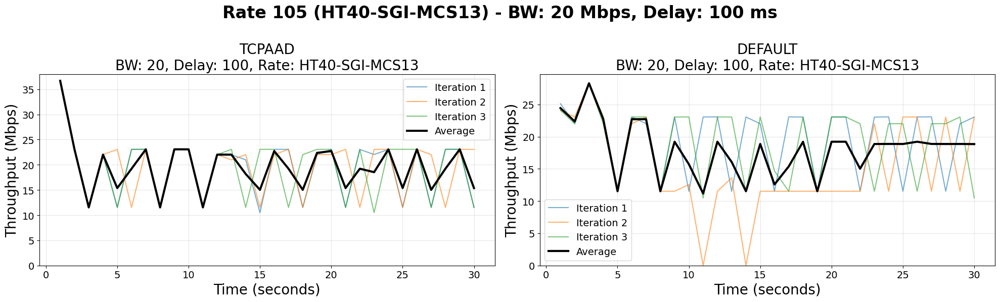

Rate 105, BW 20, Delay nodelay


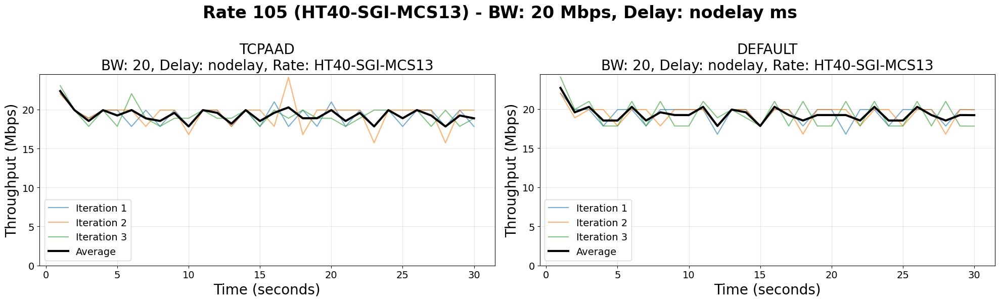

Rate 105, BW 50, Delay 10


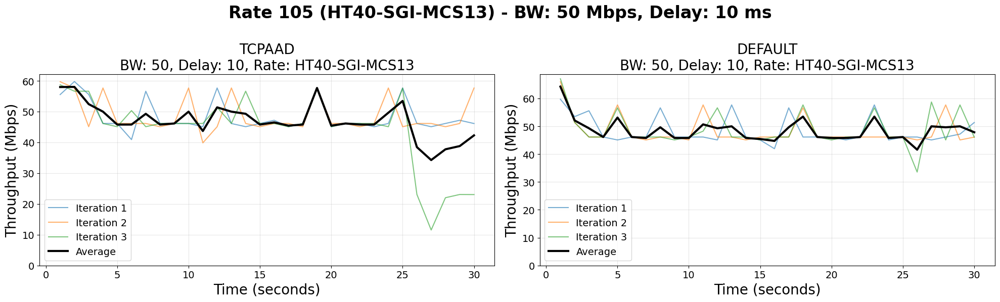

Rate 105, BW 50, Delay 50


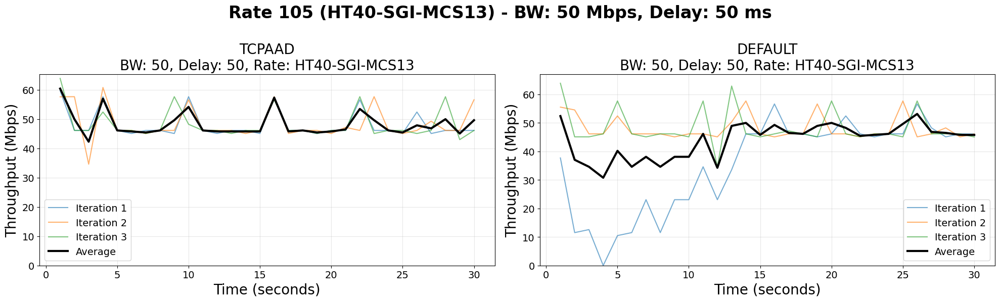

Rate 105, BW 50, Delay 100


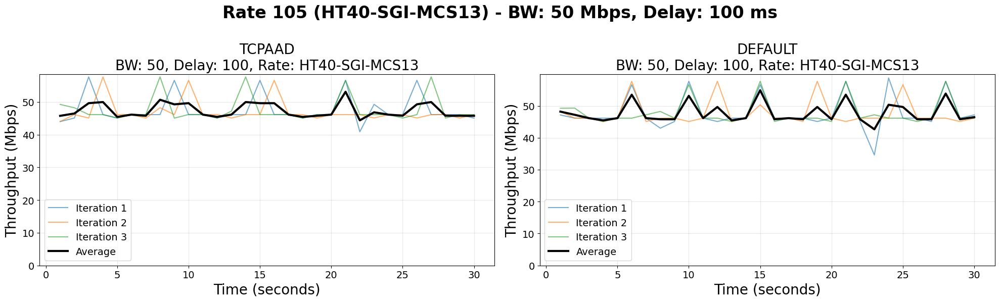

Rate 105, BW 50, Delay nodelay


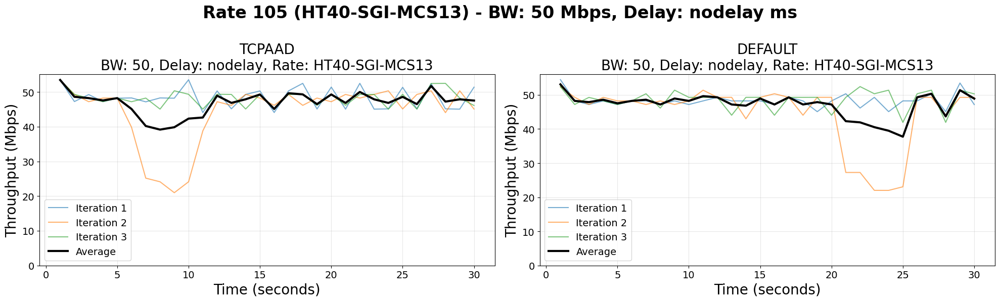

Rate 105, BW 100, Delay 10


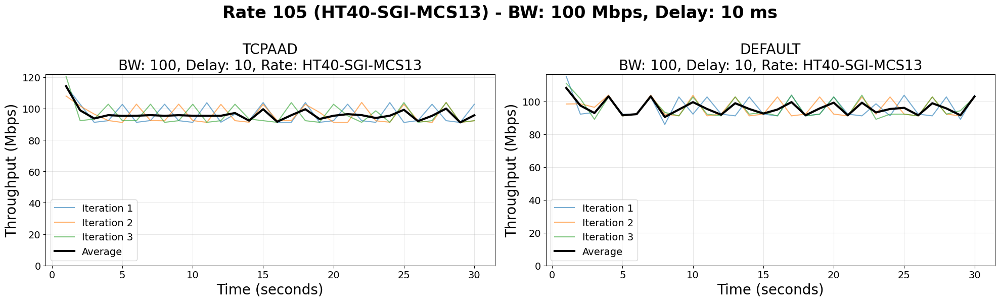

Rate 105, BW 100, Delay 50


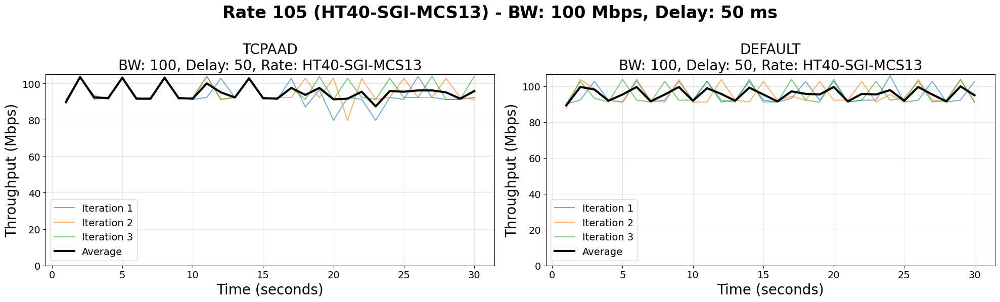

Rate 105, BW 100, Delay 100


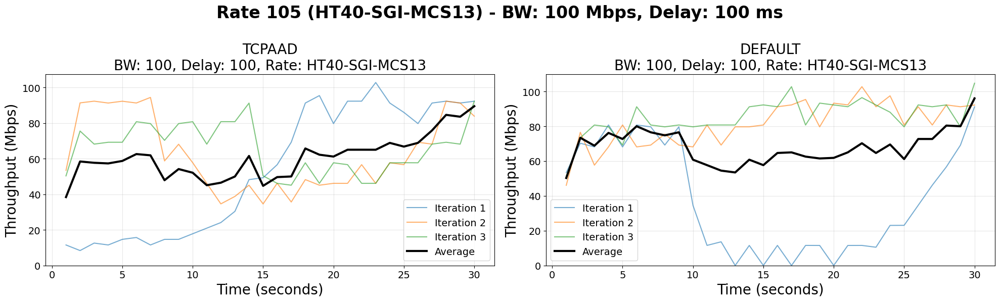

Rate 105, BW 100, Delay nodelay


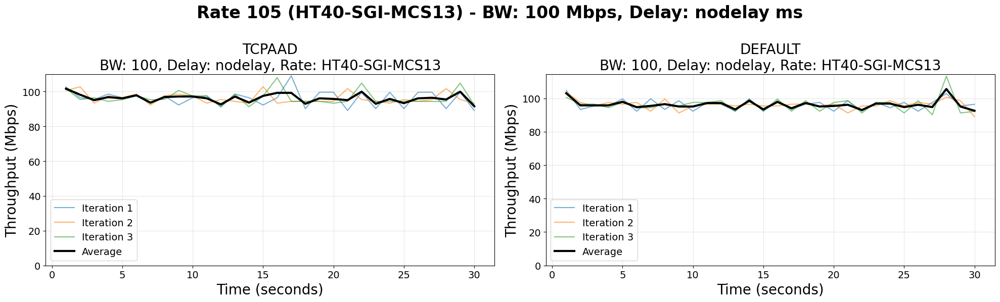

Rate 105, BW nolim, Delay 10


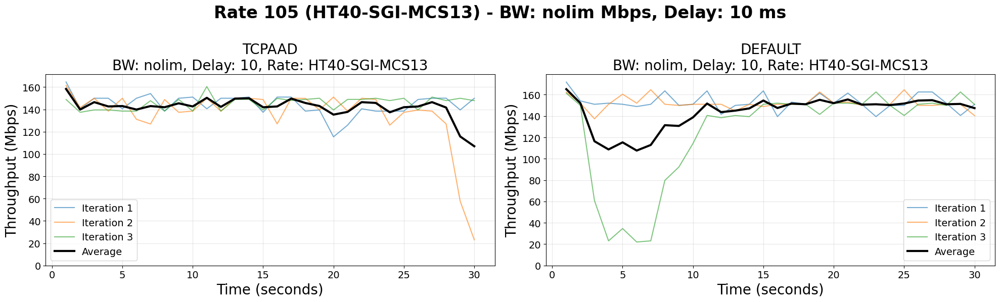

Rate 105, BW nolim, Delay 50


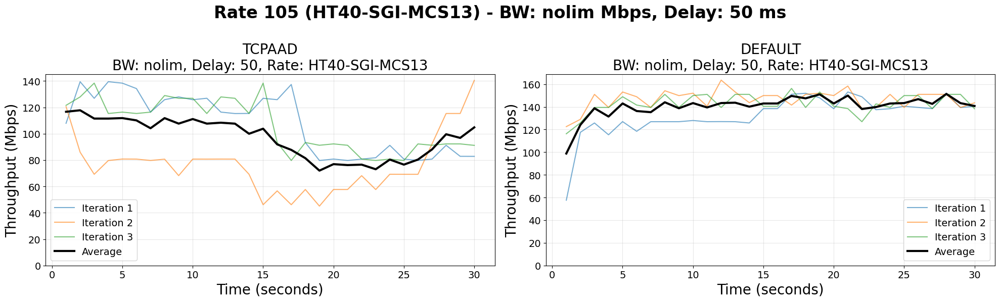

Rate 105, BW nolim, Delay 100


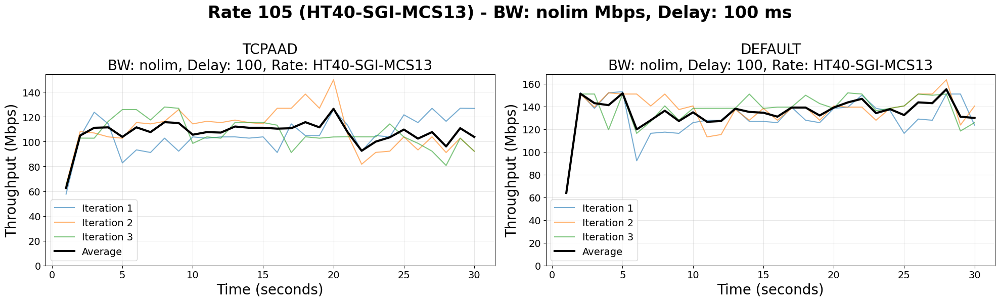

Rate 105, BW nolim, Delay nodelay


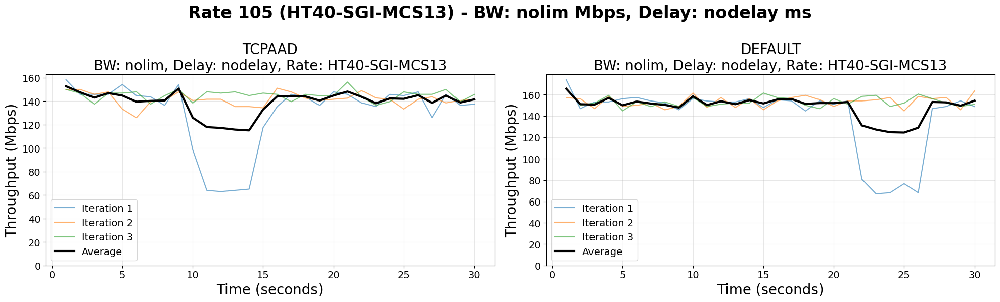

In [8]:
rate = 105
for bw in BANDWIDTHS:
    for delay in DELAYS:
        print(f"Rate {rate}, BW {bw}, Delay {delay}")
        plot_config_comparison(rate, bw, delay)

## Rate 104: HT40-SGI-MCS12

Rate 104, BW 20, Delay 10


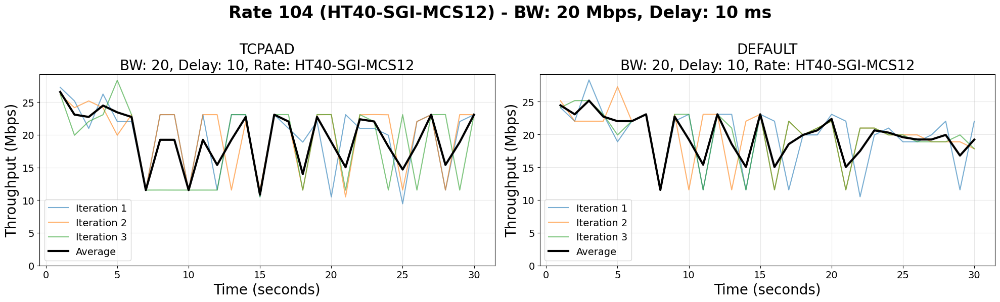

Rate 104, BW 20, Delay 50


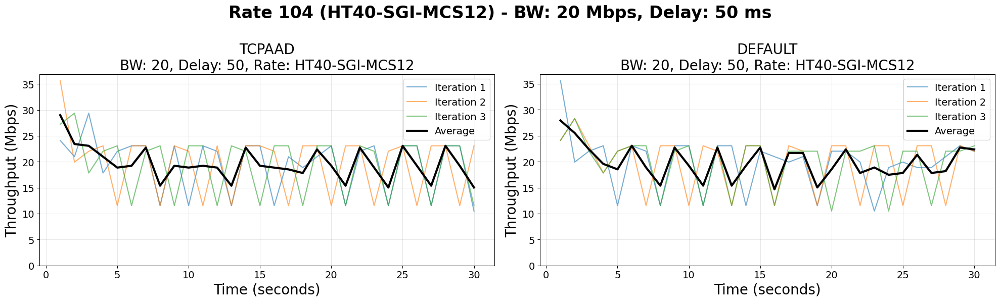

Rate 104, BW 20, Delay 100


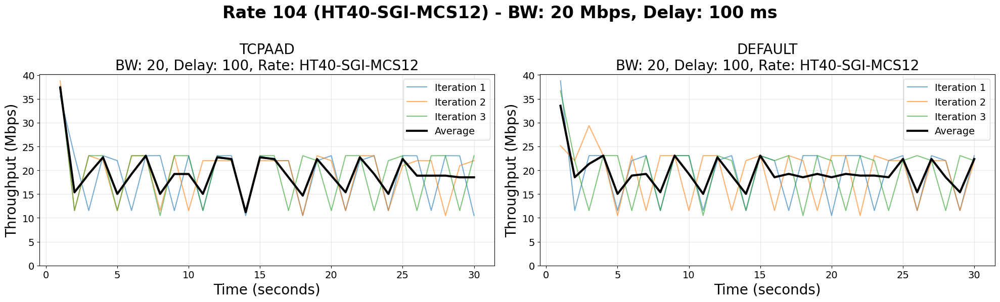

Rate 104, BW 20, Delay nodelay


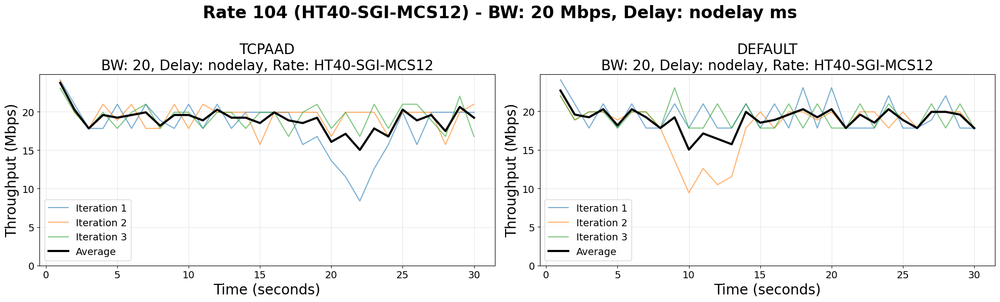

Rate 104, BW 50, Delay 10


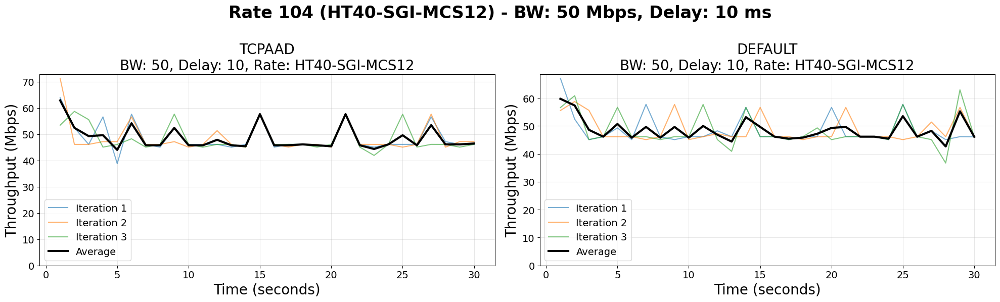

Rate 104, BW 50, Delay 50


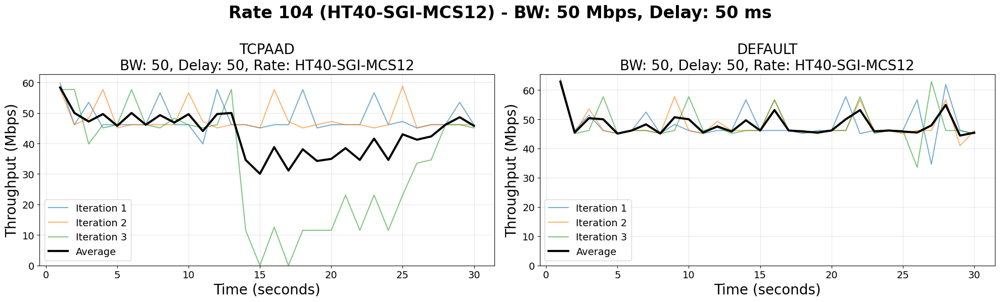

Rate 104, BW 50, Delay 100


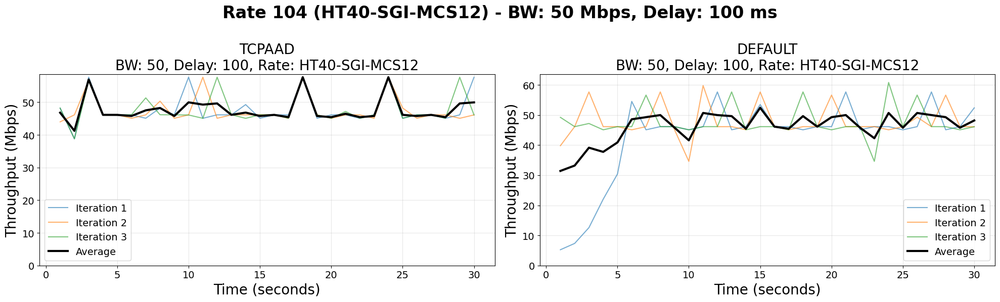

Rate 104, BW 50, Delay nodelay


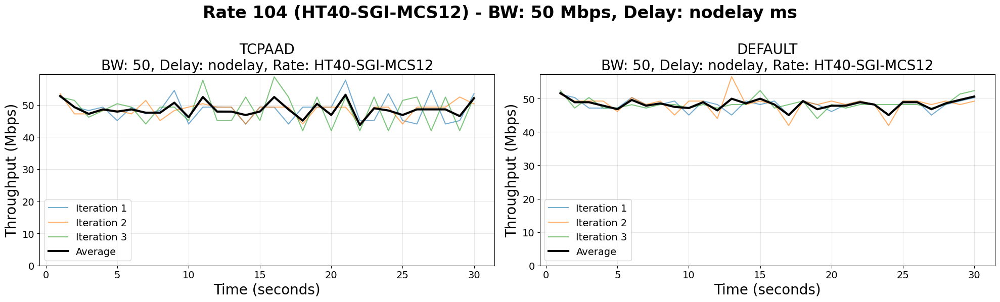

Rate 104, BW 100, Delay 10


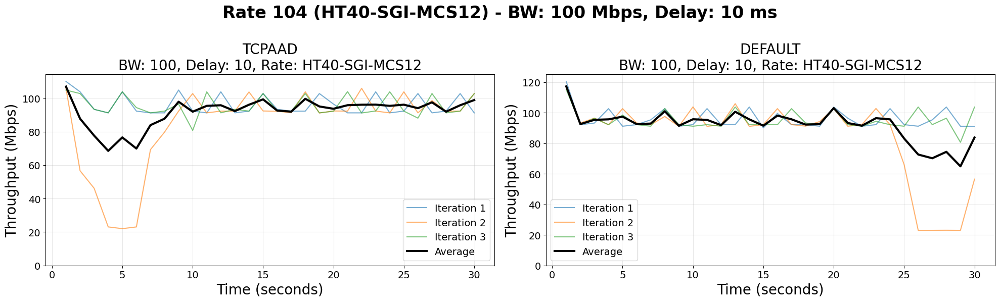

Rate 104, BW 100, Delay 50


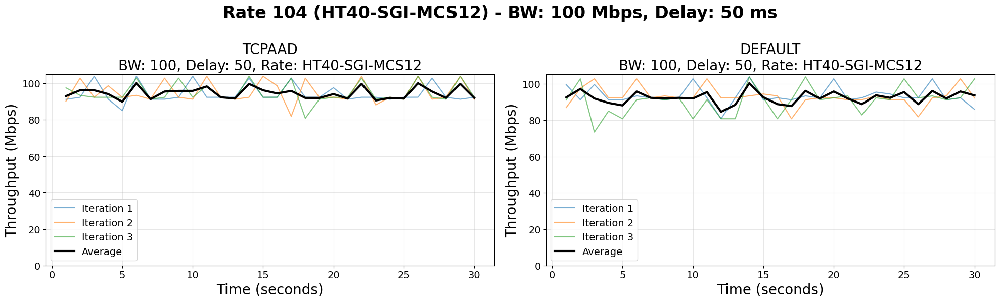

Rate 104, BW 100, Delay 100


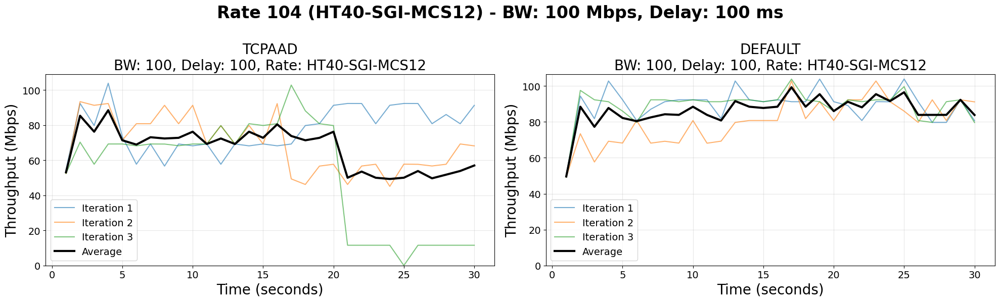

Rate 104, BW 100, Delay nodelay


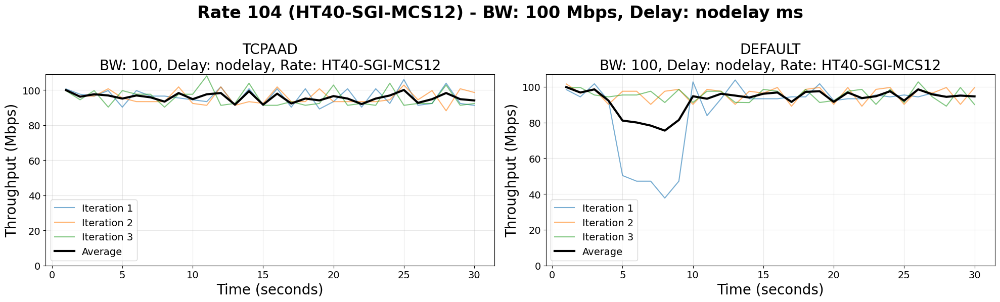

Rate 104, BW nolim, Delay 10


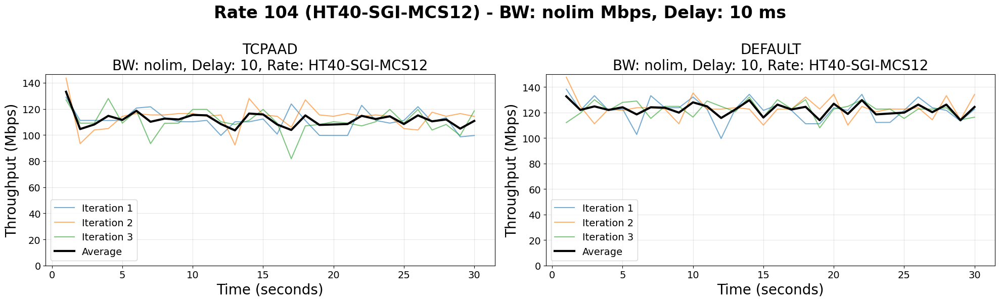

Rate 104, BW nolim, Delay 50


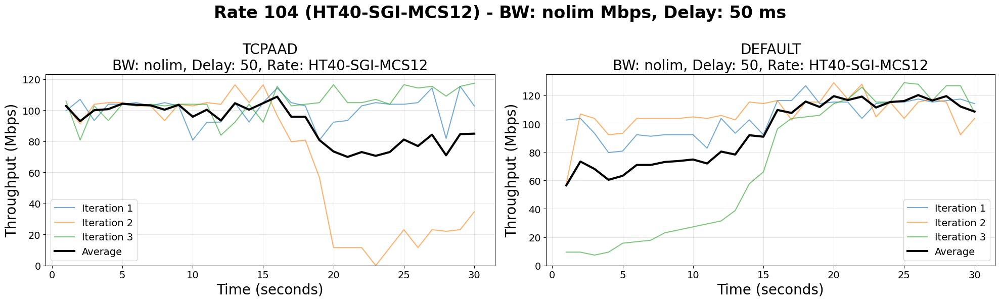

Rate 104, BW nolim, Delay 100


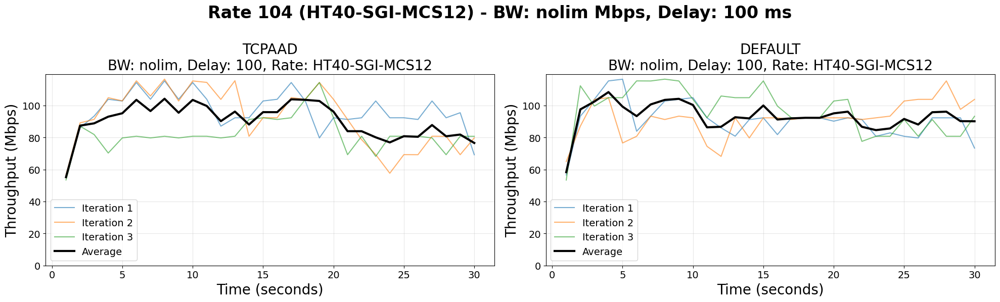

Rate 104, BW nolim, Delay nodelay


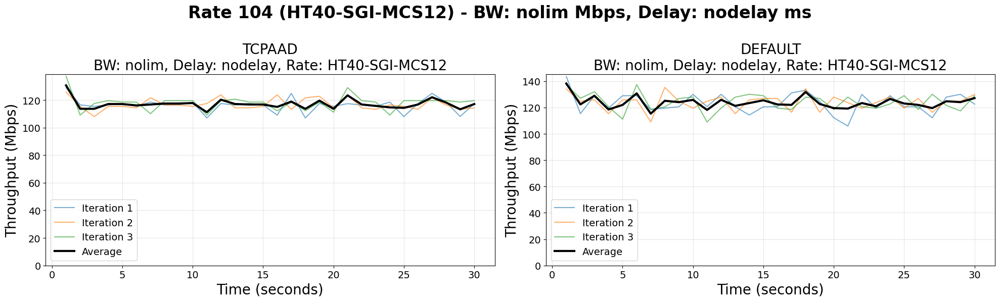

In [9]:
rate = 104
for bw in BANDWIDTHS:
    for delay in DELAYS:
        print(f"Rate {rate}, BW {bw}, Delay {delay}")
        plot_config_comparison(rate, bw, delay)

## Rate 96: HT40-SGI-MCS6

Rate 96, BW 20, Delay 10


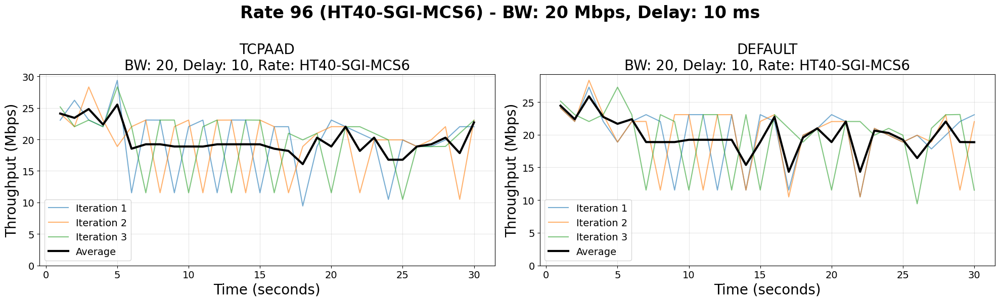

Rate 96, BW 20, Delay 50


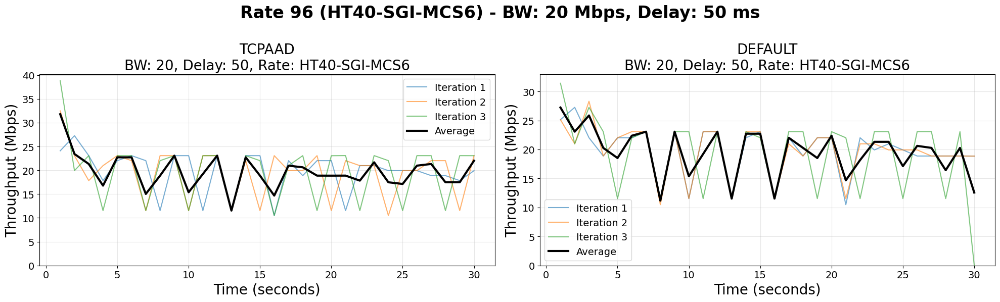

Rate 96, BW 20, Delay 100


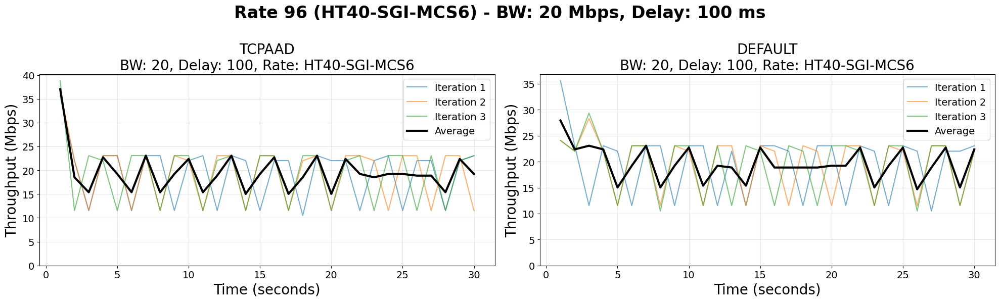

Rate 96, BW 20, Delay nodelay


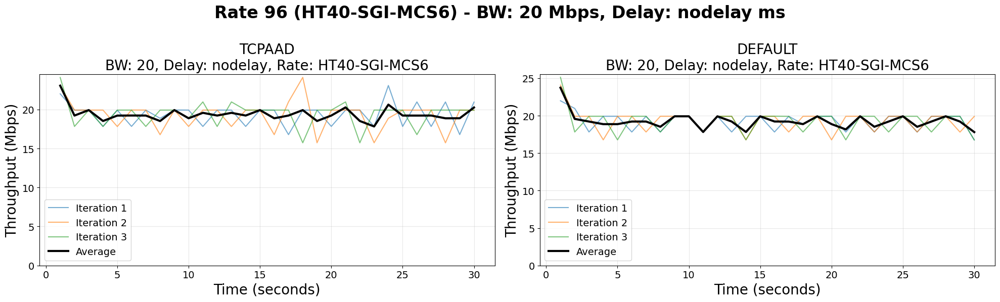

Rate 96, BW 50, Delay 10


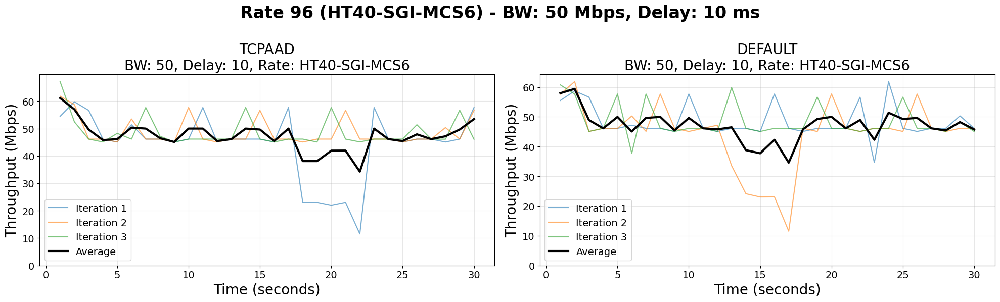

Rate 96, BW 50, Delay 50


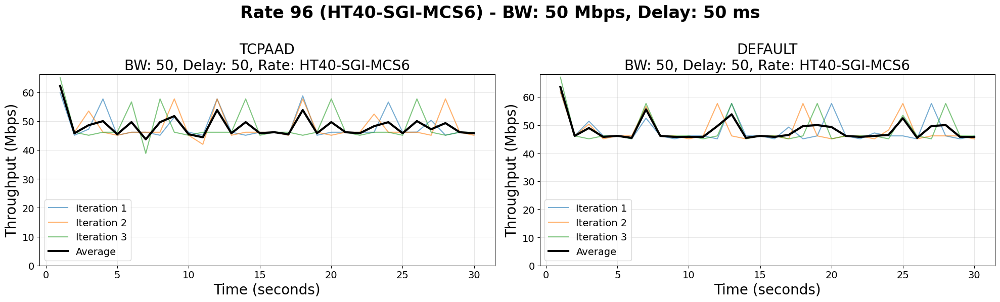

Rate 96, BW 50, Delay 100


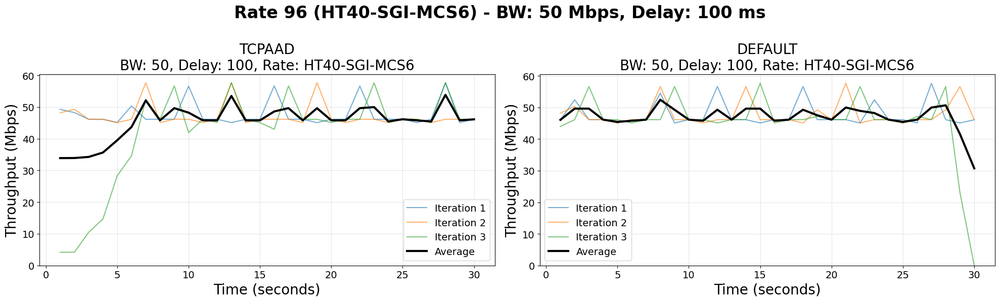

Rate 96, BW 50, Delay nodelay


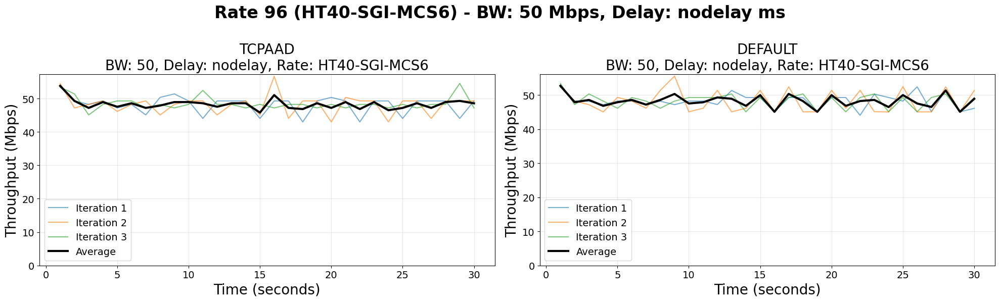

Rate 96, BW 100, Delay 10


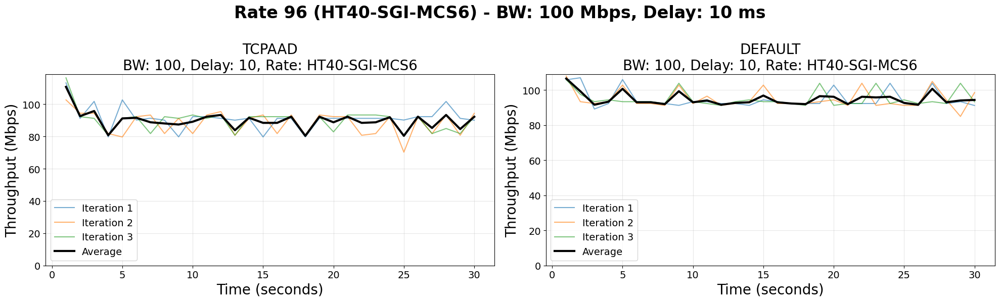

Rate 96, BW 100, Delay 50


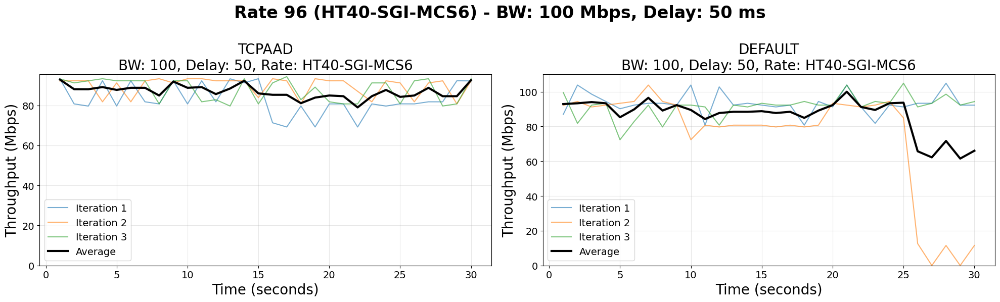

Rate 96, BW 100, Delay 100


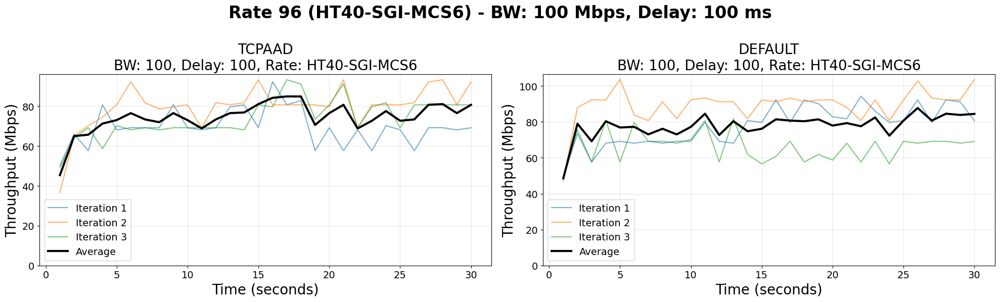

Rate 96, BW 100, Delay nodelay


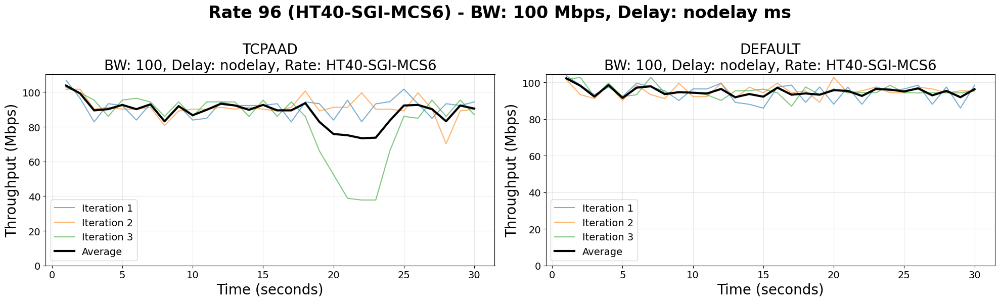

Rate 96, BW nolim, Delay 10


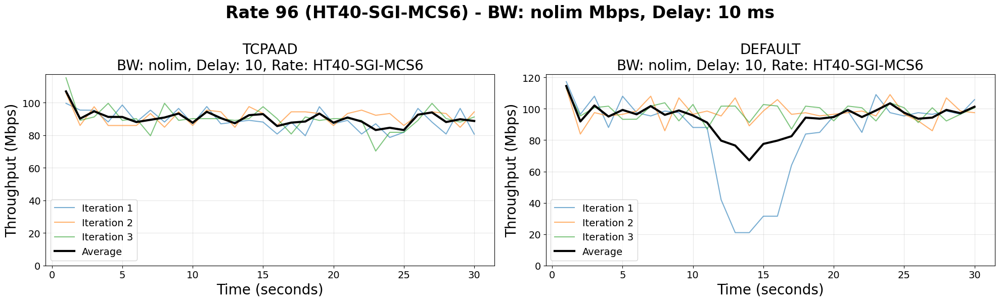

Rate 96, BW nolim, Delay 50


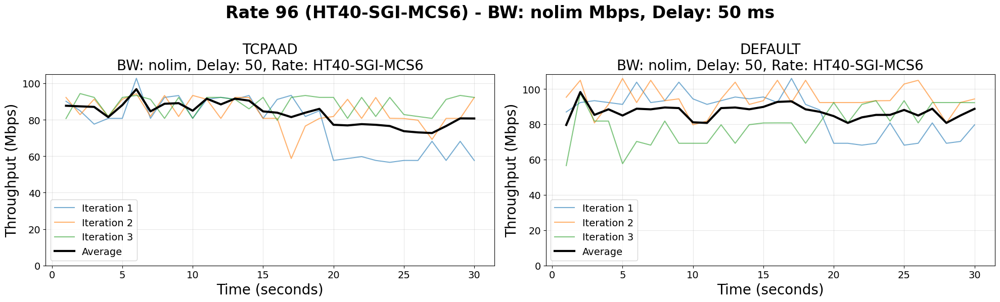

Rate 96, BW nolim, Delay 100


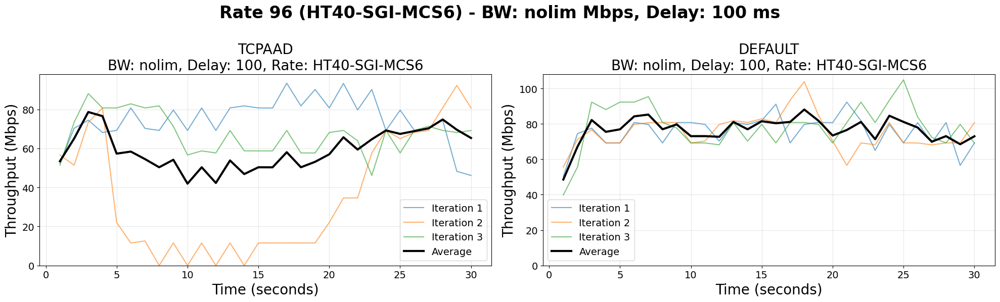

Rate 96, BW nolim, Delay nodelay


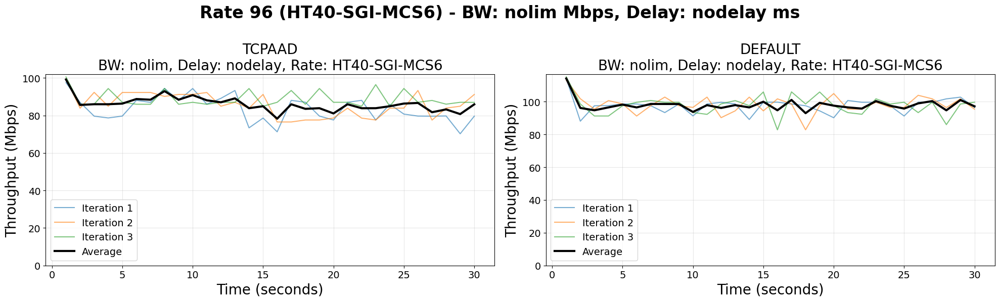

In [10]:
rate = 96
for bw in BANDWIDTHS:
    for delay in DELAYS:
        print(f"Rate {rate}, BW {bw}, Delay {delay}")
        plot_config_comparison(rate, bw, delay)

## Rate 95: HT40-SGI-MCS5

Rate 95, BW 20, Delay 10


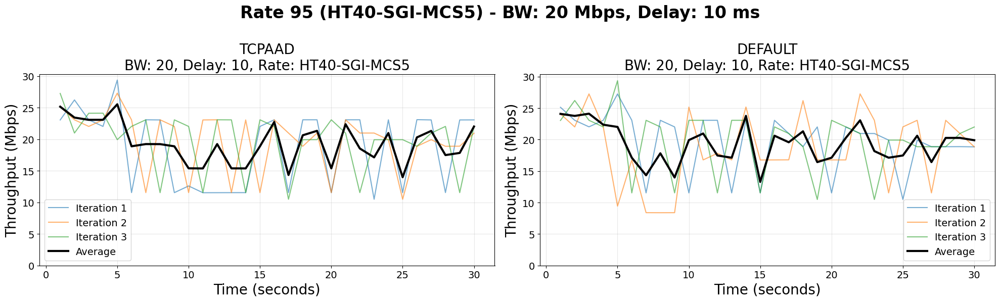

Rate 95, BW 20, Delay 50


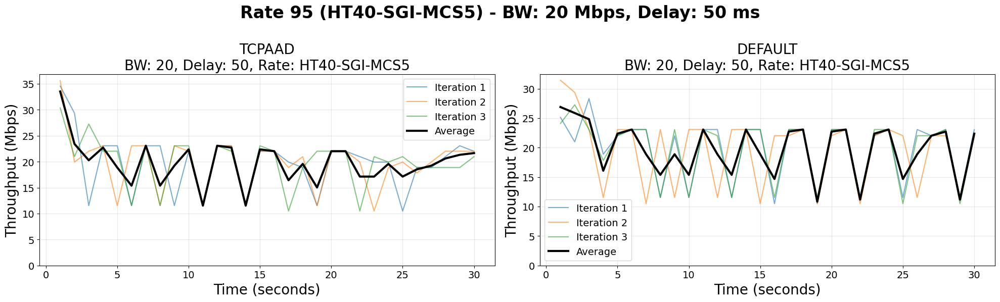

Rate 95, BW 20, Delay 100


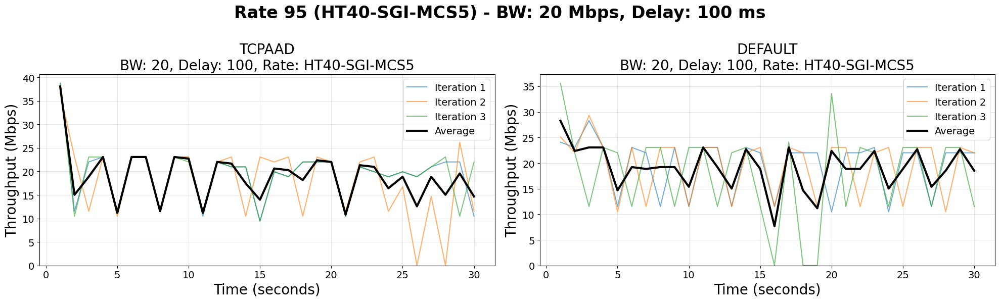

Rate 95, BW 20, Delay nodelay


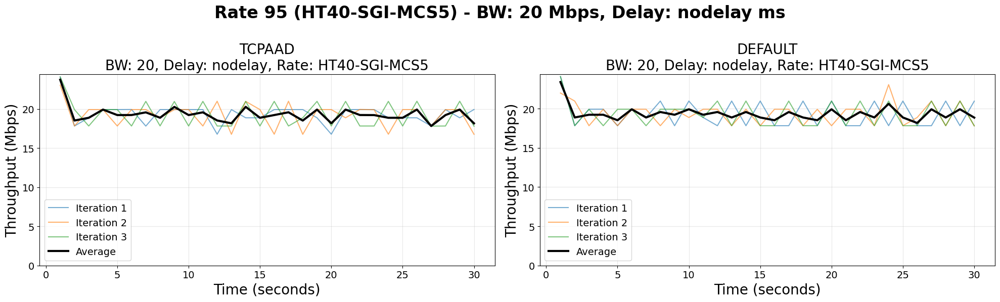

Rate 95, BW 50, Delay 10


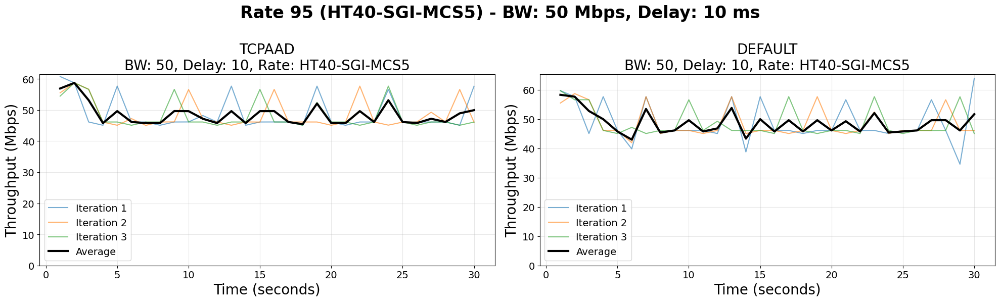

Rate 95, BW 50, Delay 50


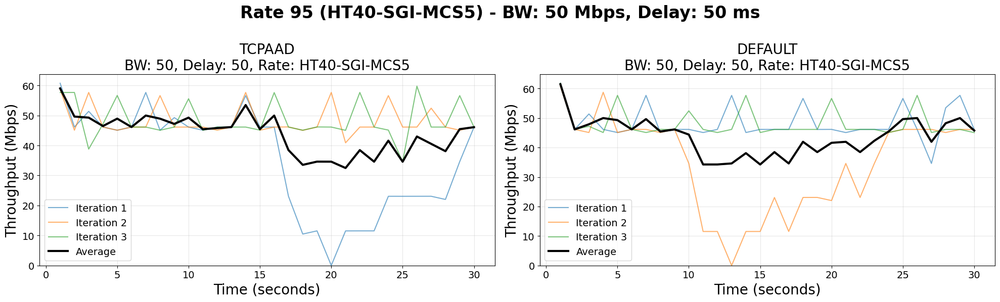

Rate 95, BW 50, Delay 100


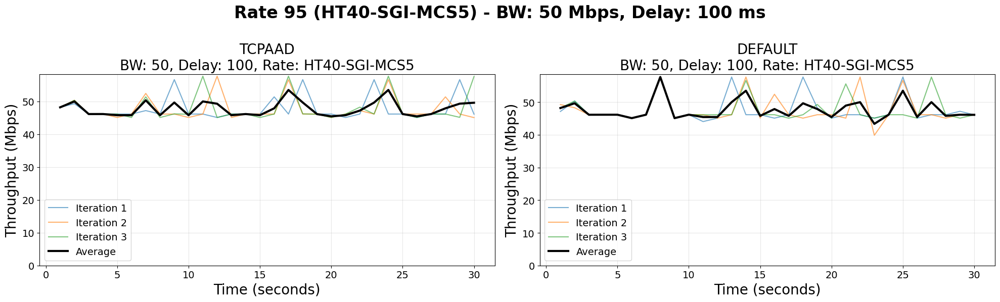

Rate 95, BW 50, Delay nodelay


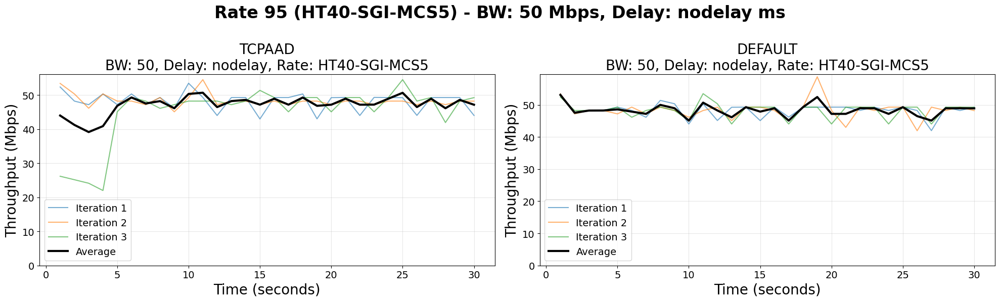

Rate 95, BW 100, Delay 10


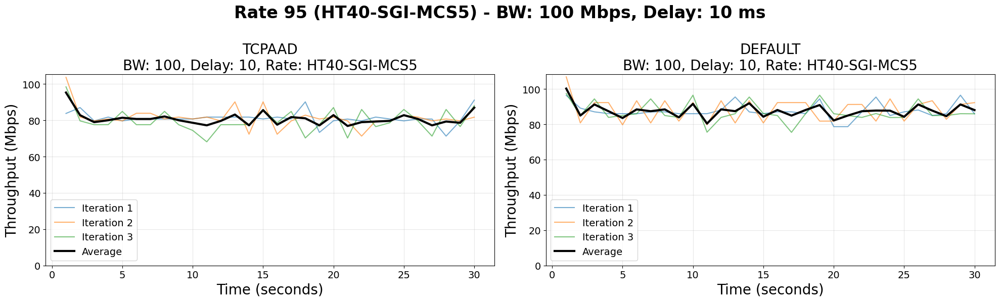

Rate 95, BW 100, Delay 50


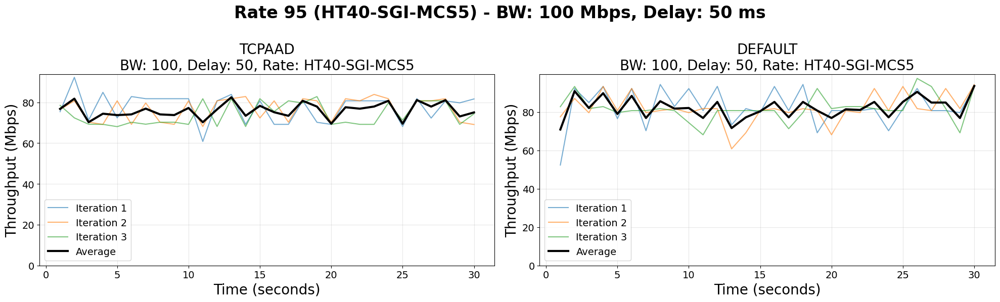

Rate 95, BW 100, Delay 100


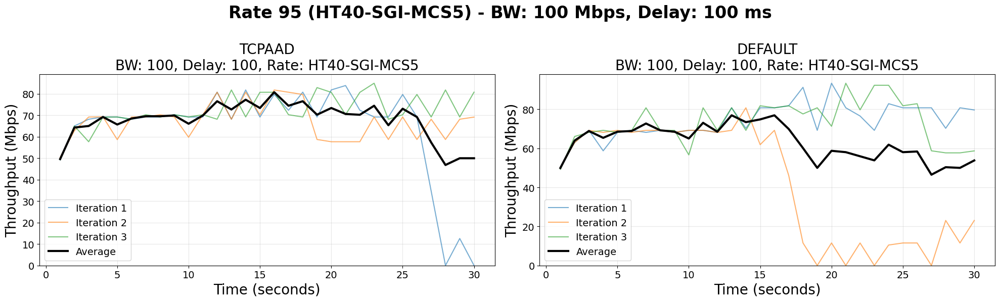

Rate 95, BW 100, Delay nodelay


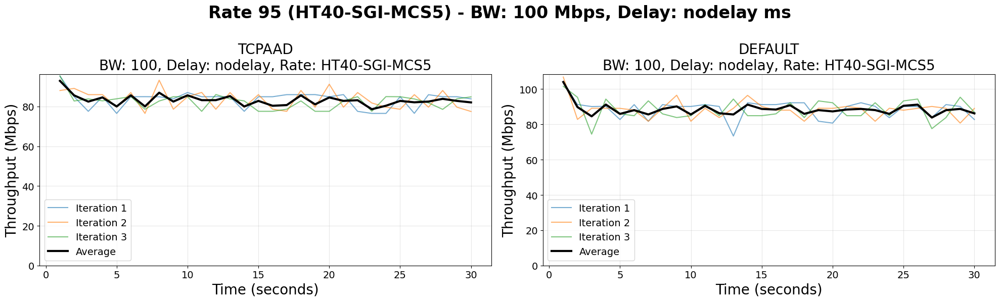

Rate 95, BW nolim, Delay 10


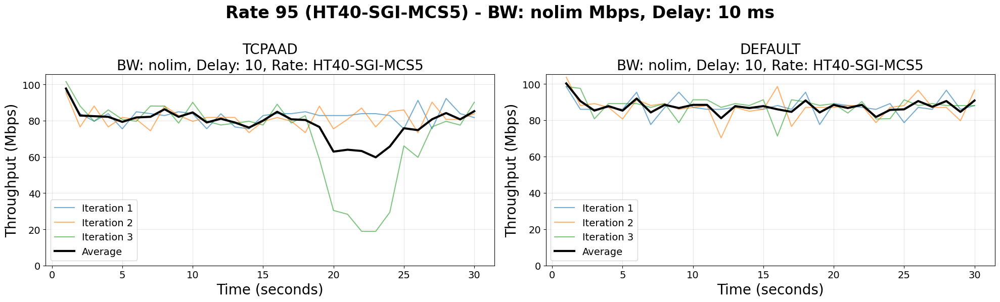

Rate 95, BW nolim, Delay 50


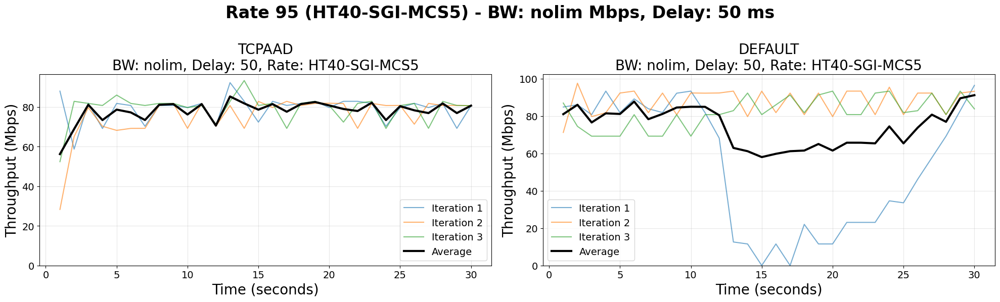

Rate 95, BW nolim, Delay 100


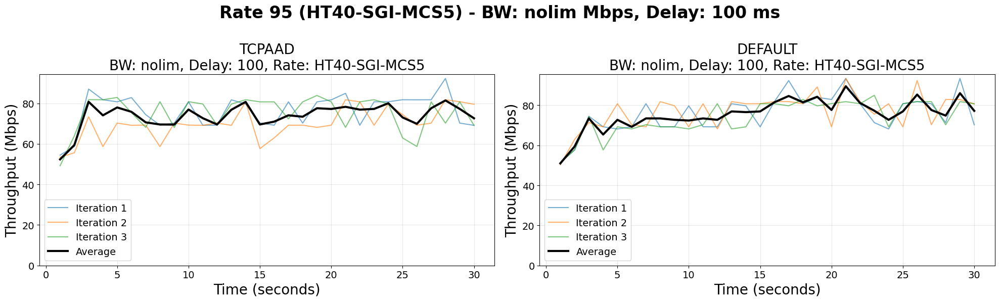

Rate 95, BW nolim, Delay nodelay


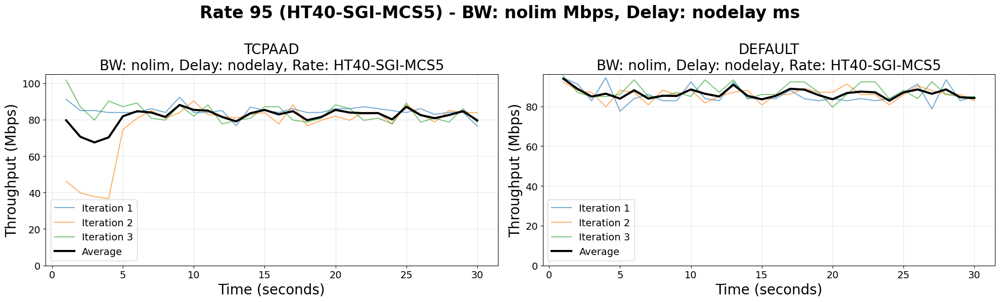

In [11]:
rate = 95
for bw in BANDWIDTHS:
    for delay in DELAYS:
        print(f"Rate {rate}, BW {bw}, Delay {delay}")
        plot_config_comparison(rate, bw, delay)

## Rate 94: HT40-SGI-MCS4

Rate 94, BW 20, Delay 10


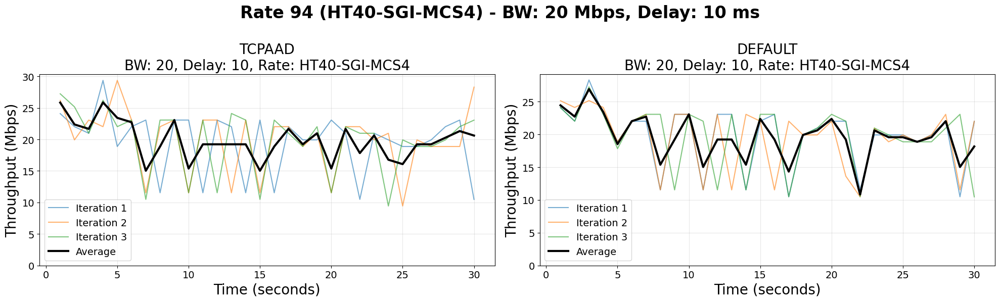

Rate 94, BW 20, Delay 50


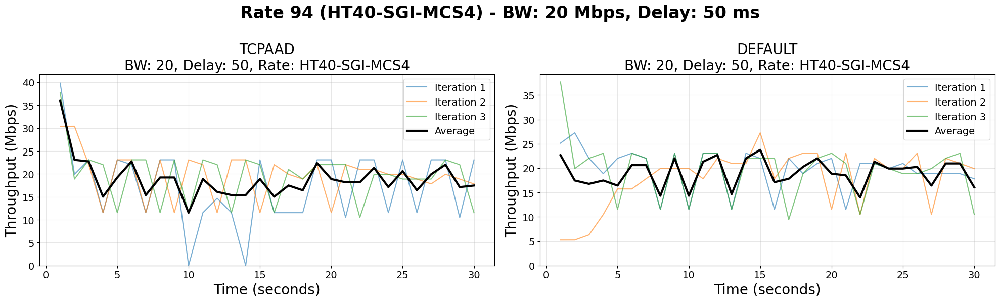

Rate 94, BW 20, Delay 100


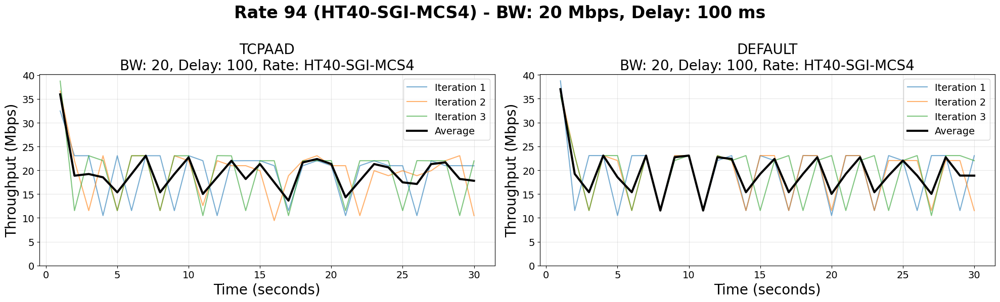

Rate 94, BW 20, Delay nodelay


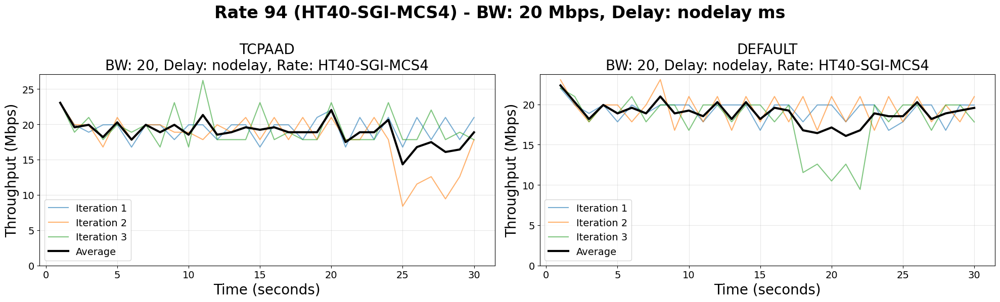

Rate 94, BW 50, Delay 10


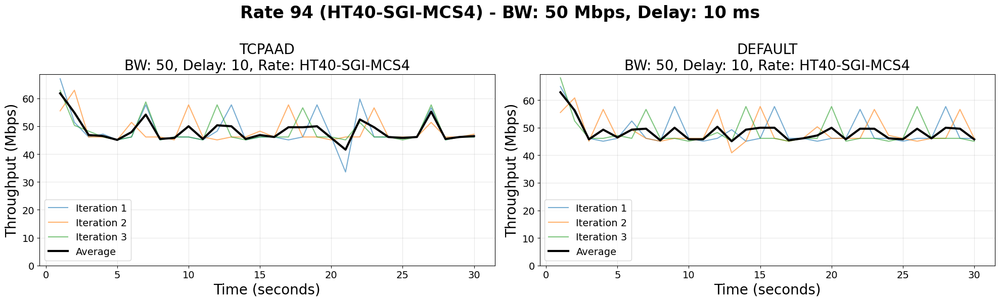

Rate 94, BW 50, Delay 50


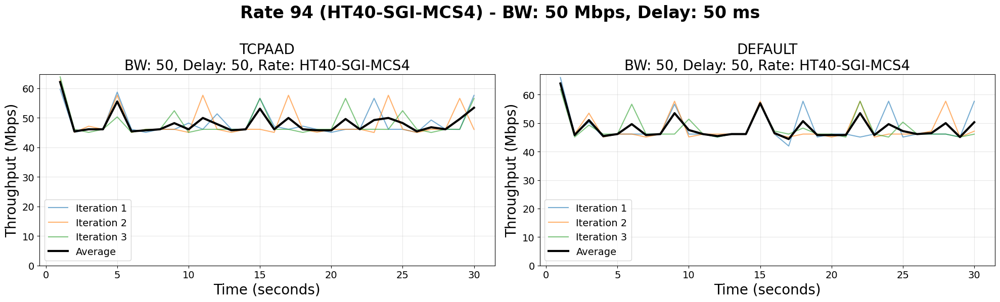

Rate 94, BW 50, Delay 100


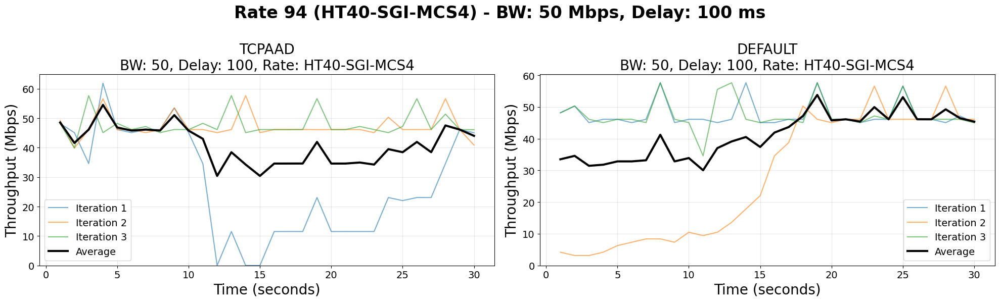

Rate 94, BW 50, Delay nodelay


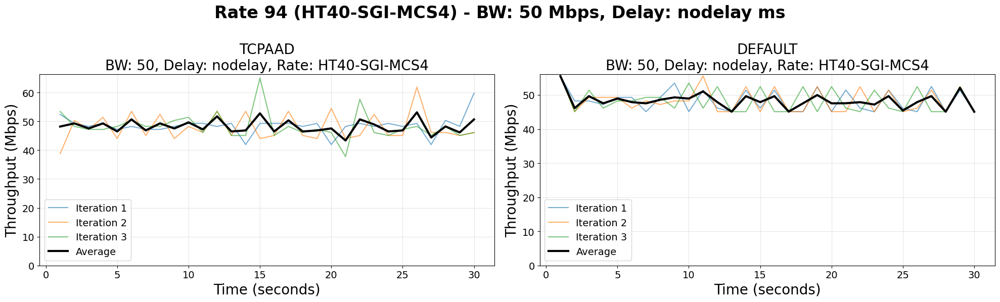

Rate 94, BW 100, Delay 10


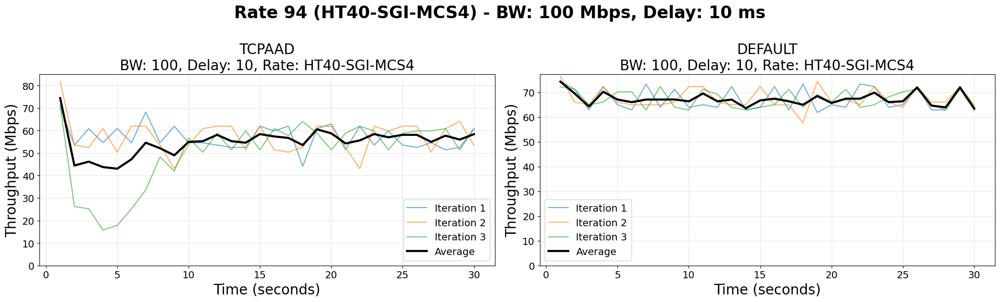

Rate 94, BW 100, Delay 50


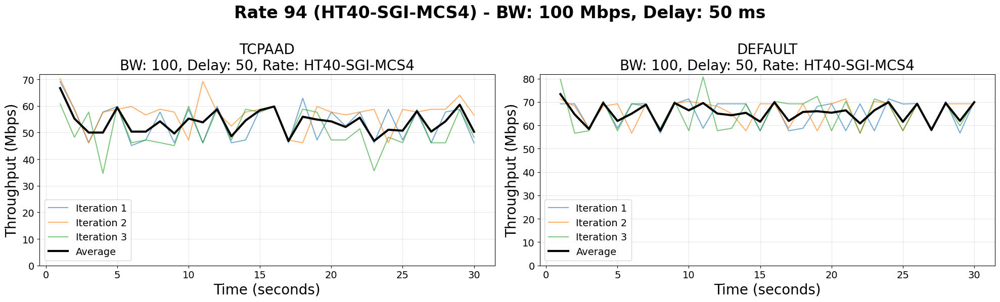

Rate 94, BW 100, Delay 100


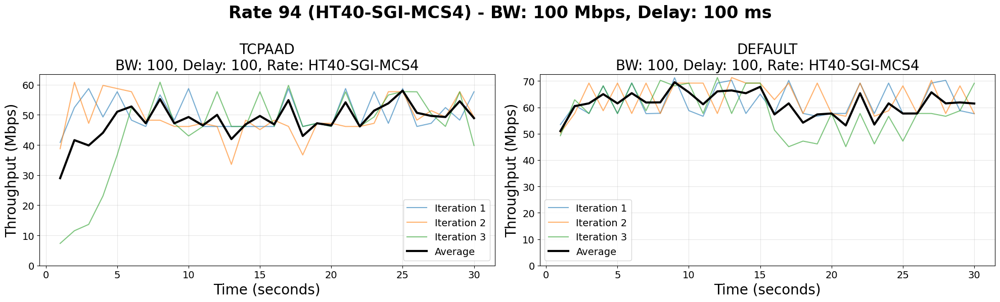

Rate 94, BW 100, Delay nodelay


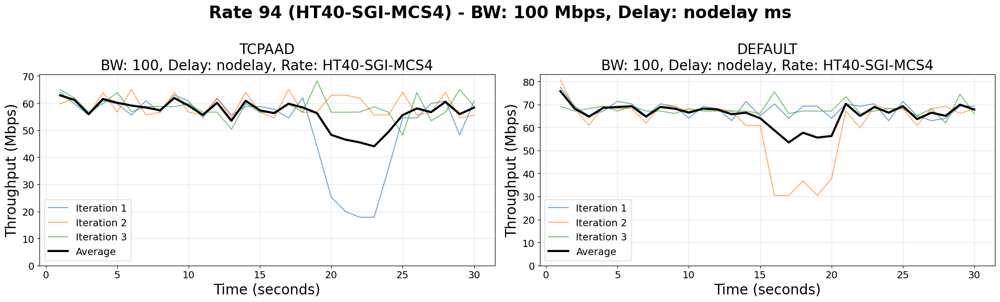

Rate 94, BW nolim, Delay 10


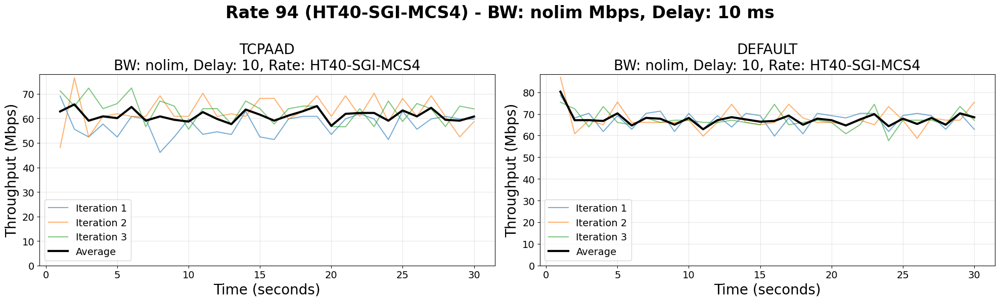

Rate 94, BW nolim, Delay 50


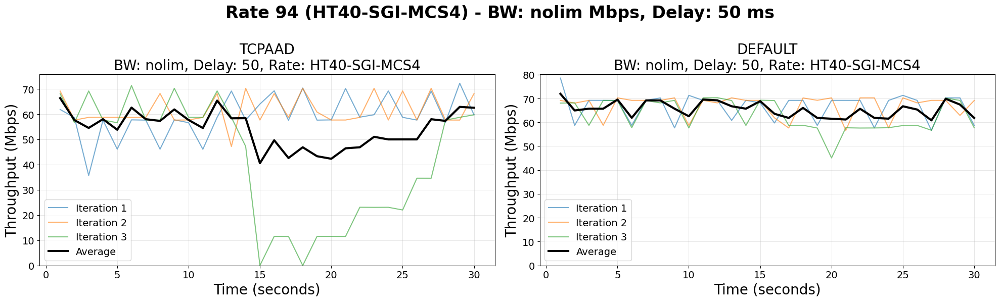

Rate 94, BW nolim, Delay 100


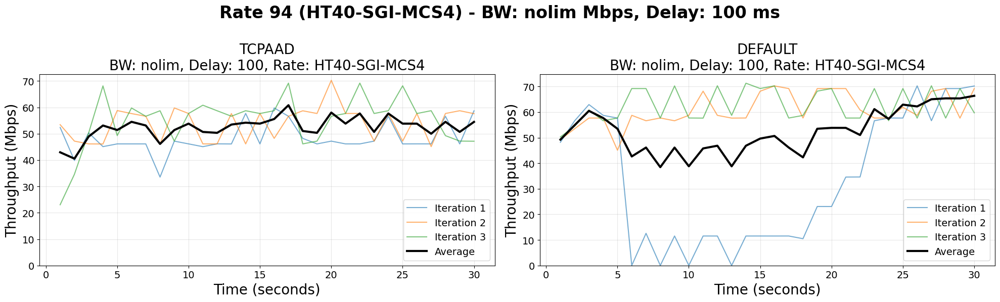

Rate 94, BW nolim, Delay nodelay


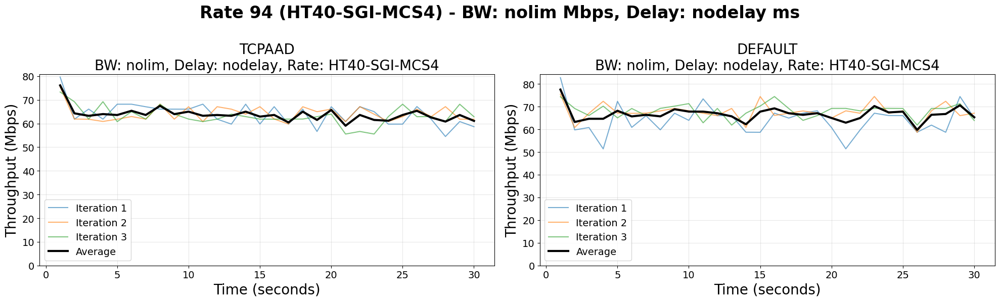

In [12]:
rate = 94
for bw in BANDWIDTHS:
    for delay in DELAYS:
        print(f"Rate {rate}, BW {bw}, Delay {delay}")
        plot_config_comparison(rate, bw, delay)

## Rate 46: HT20-SGI-MCS14

Rate 46, BW 20, Delay 10


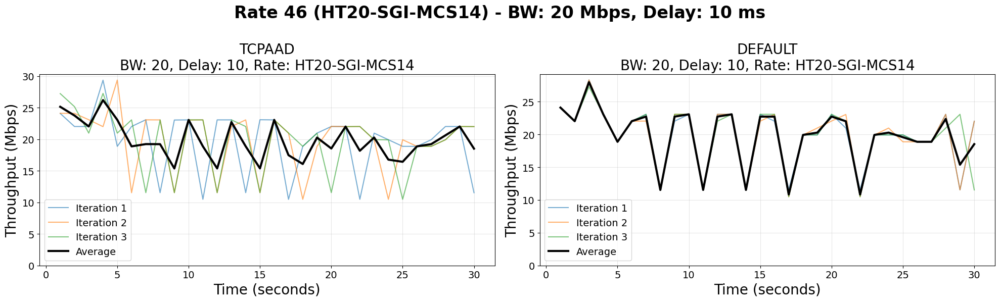

Rate 46, BW 20, Delay 50


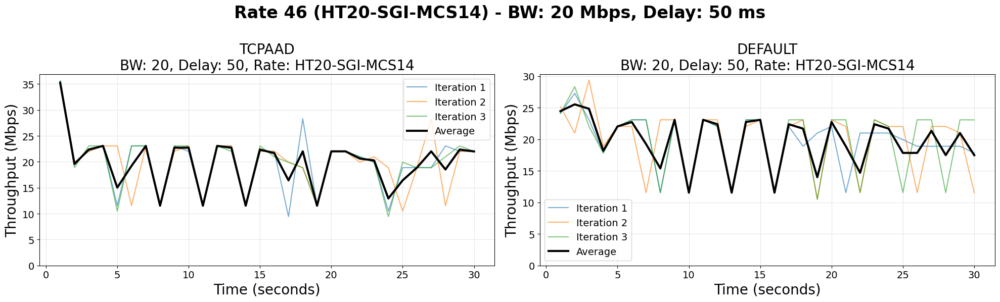

Rate 46, BW 20, Delay 100


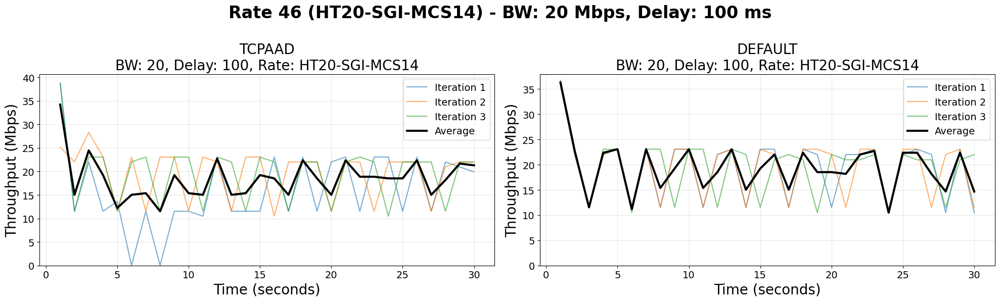

Rate 46, BW 20, Delay nodelay


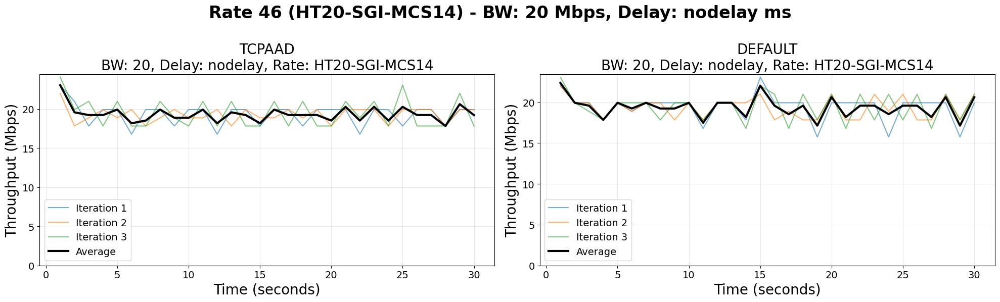

Rate 46, BW 50, Delay 10


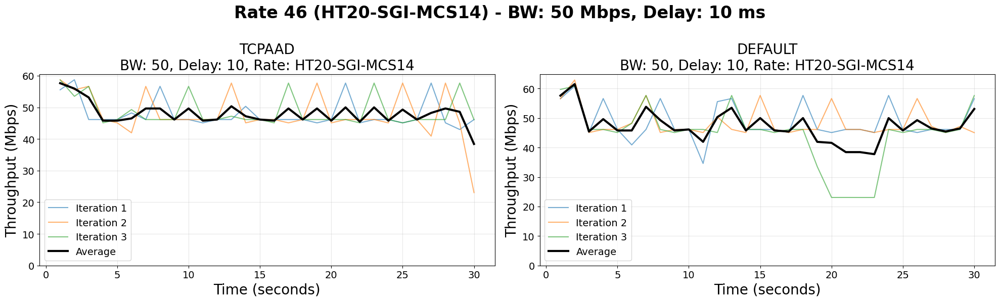

Rate 46, BW 50, Delay 50


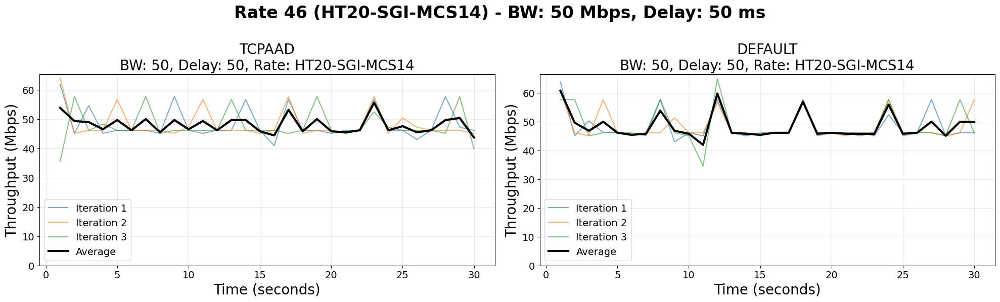

Rate 46, BW 50, Delay 100


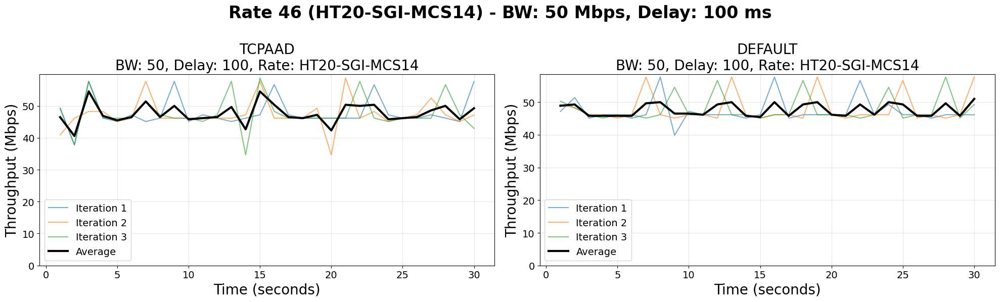

Rate 46, BW 50, Delay nodelay


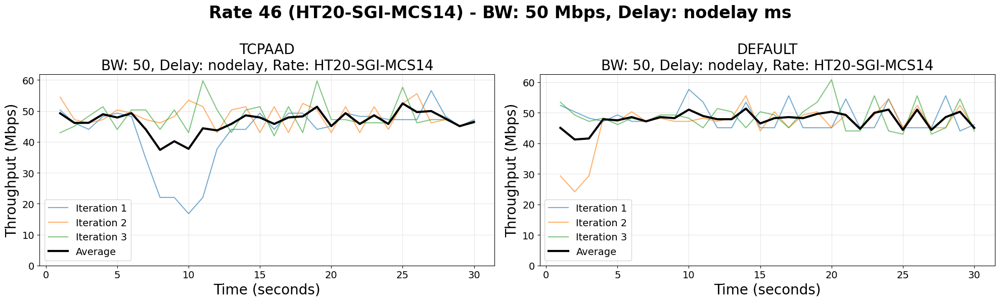

Rate 46, BW 100, Delay 10


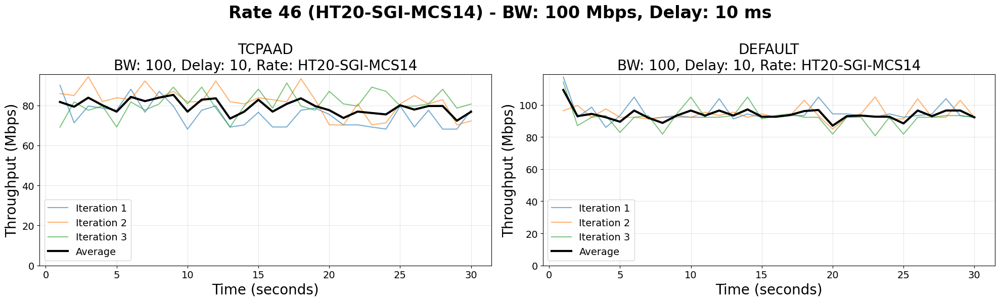

Rate 46, BW 100, Delay 50


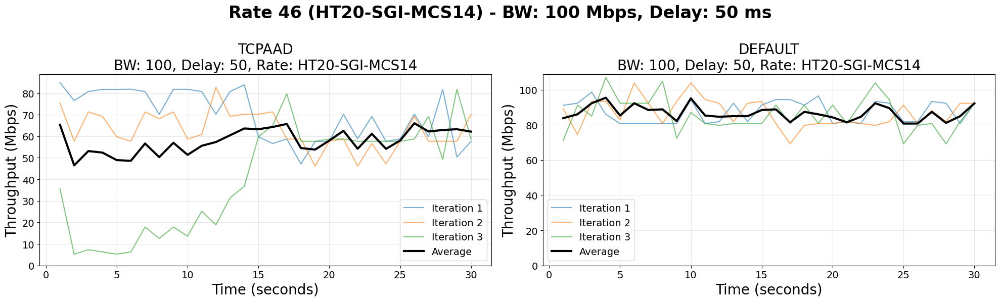

Rate 46, BW 100, Delay 100


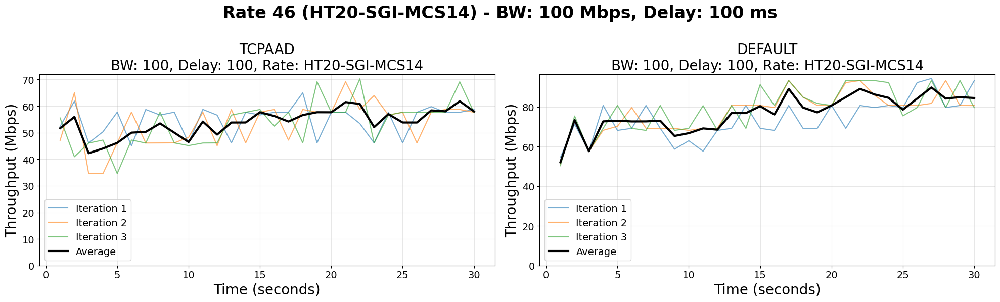

Rate 46, BW 100, Delay nodelay


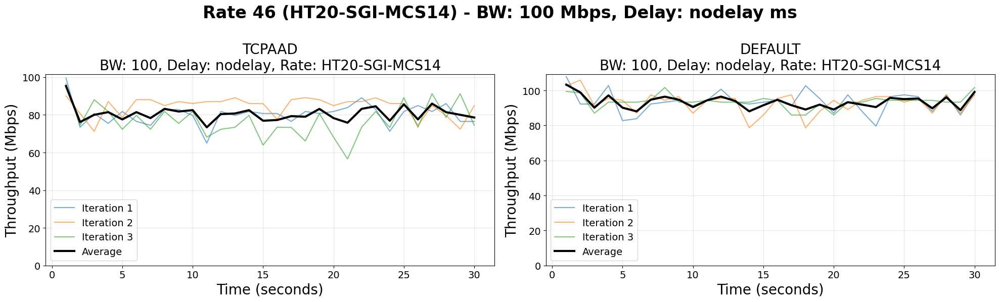

Rate 46, BW nolim, Delay 10


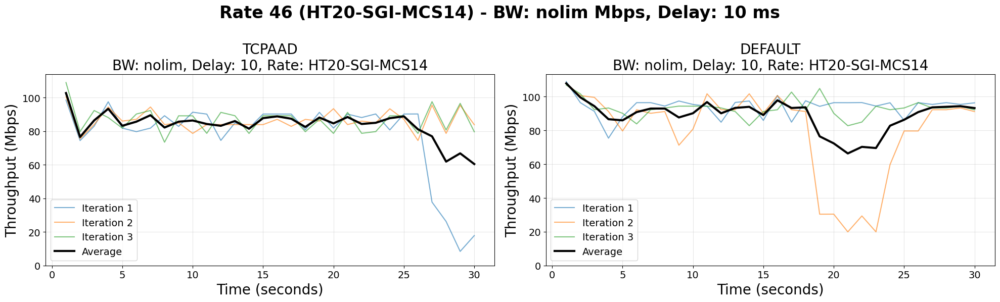

Rate 46, BW nolim, Delay 50


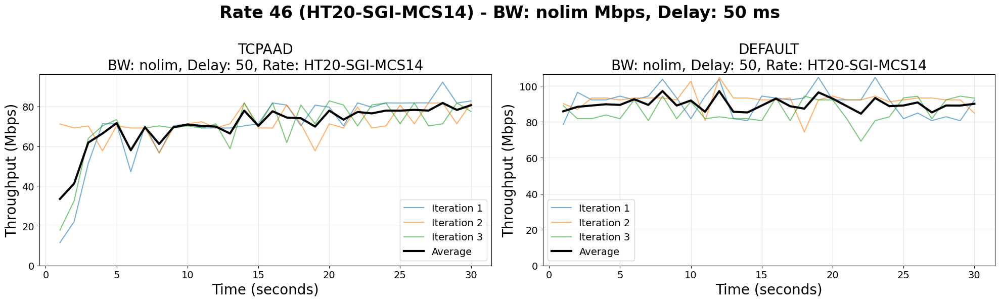

Rate 46, BW nolim, Delay 100


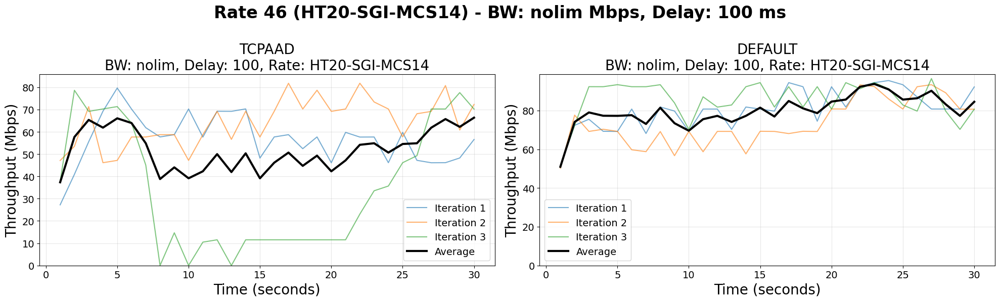

Rate 46, BW nolim, Delay nodelay


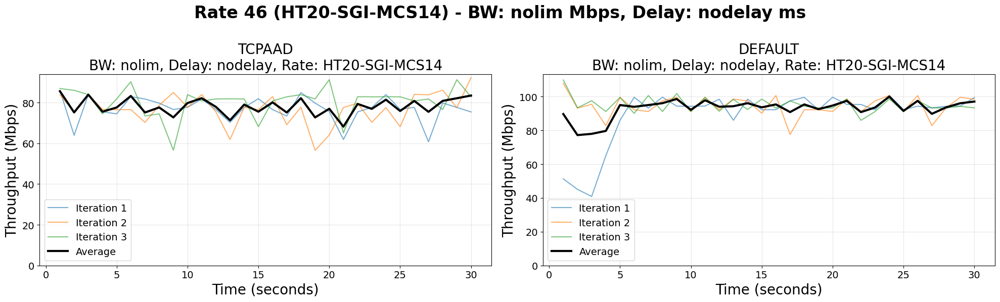

In [13]:
rate = 46
for bw in BANDWIDTHS:
    for delay in DELAYS:
        print(f"Rate {rate}, BW {bw}, Delay {delay}")
        plot_config_comparison(rate, bw, delay)

## Rate 45: HT20-SGI-MCS13

Rate 45, BW 20, Delay 10


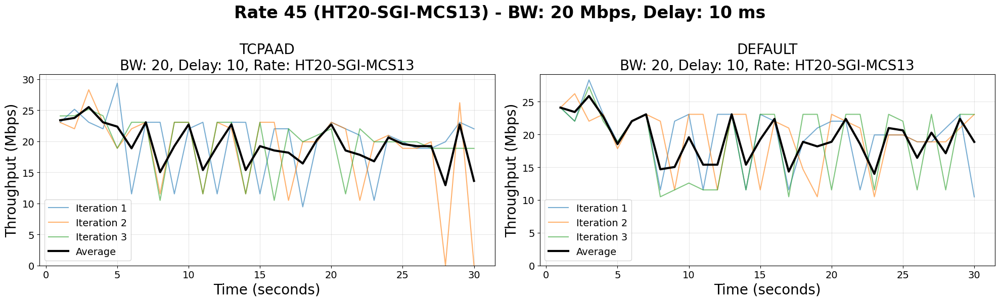

Rate 45, BW 20, Delay 50


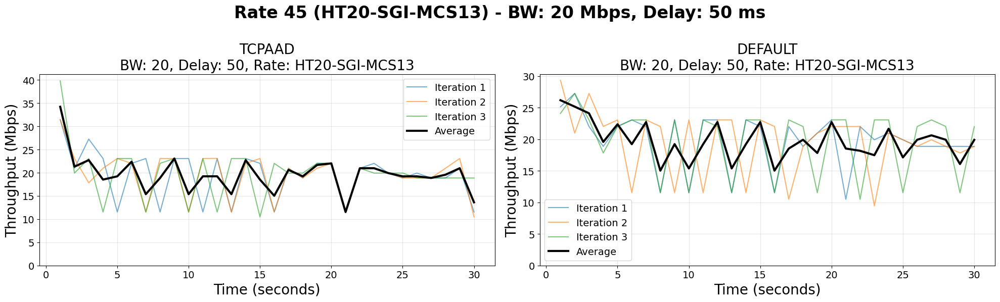

Rate 45, BW 20, Delay 100


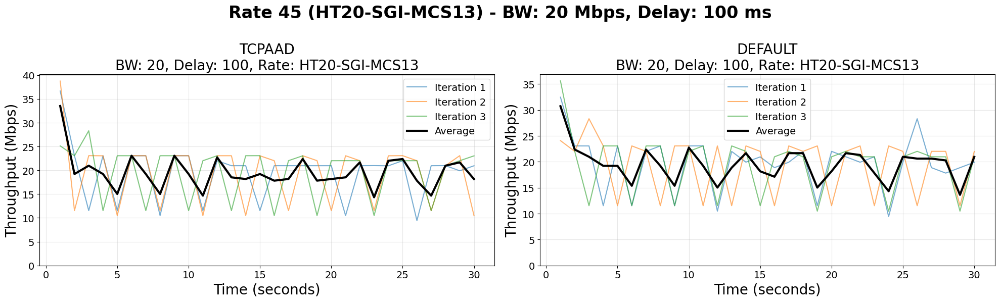

Rate 45, BW 20, Delay nodelay


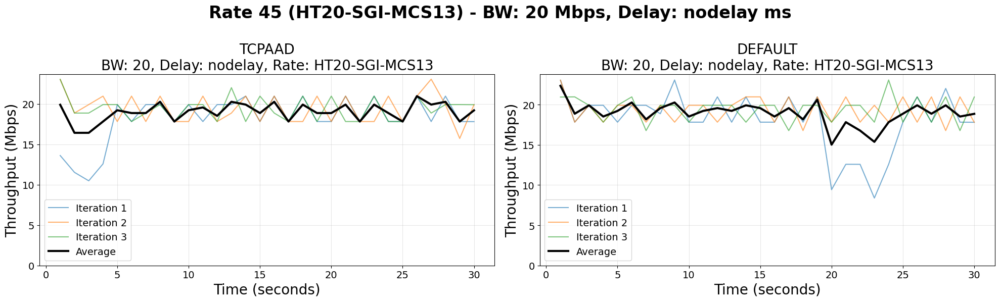

Rate 45, BW 50, Delay 10


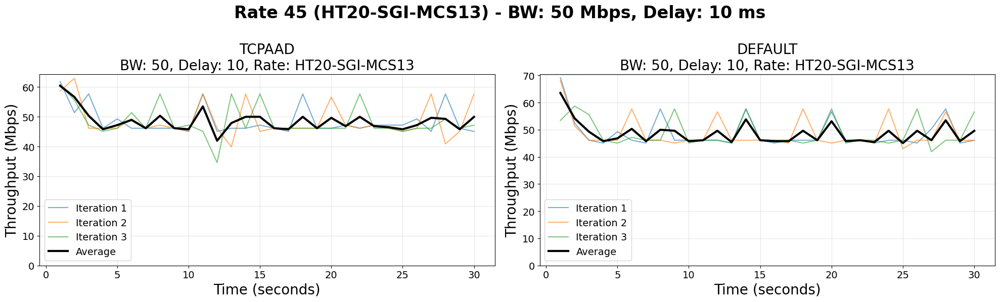

Rate 45, BW 50, Delay 50


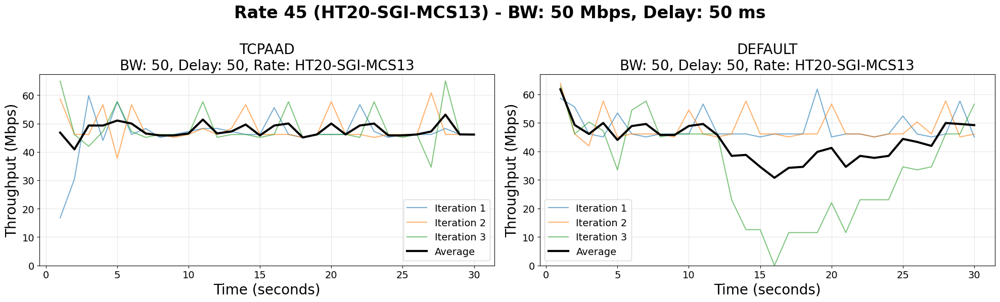

Rate 45, BW 50, Delay 100


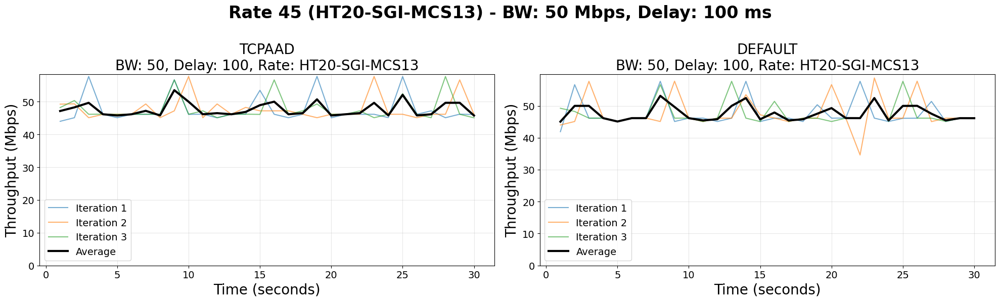

Rate 45, BW 50, Delay nodelay


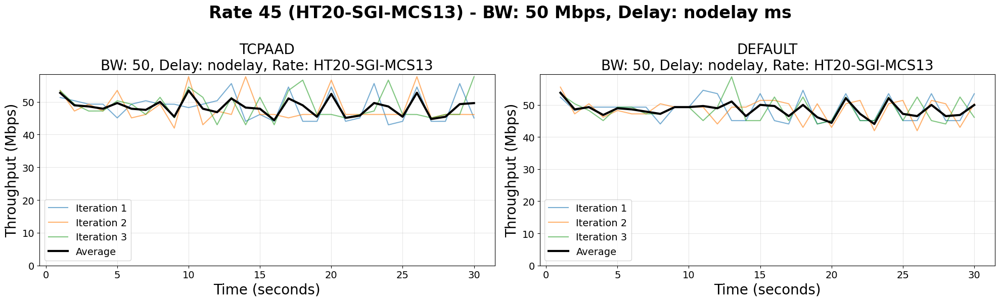

Rate 45, BW 100, Delay 10


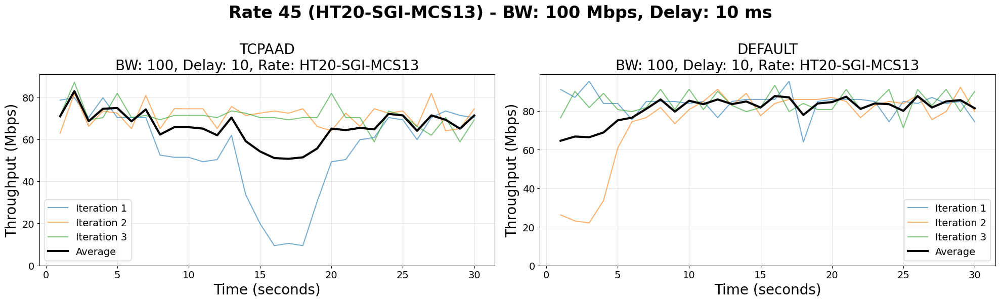

Rate 45, BW 100, Delay 50


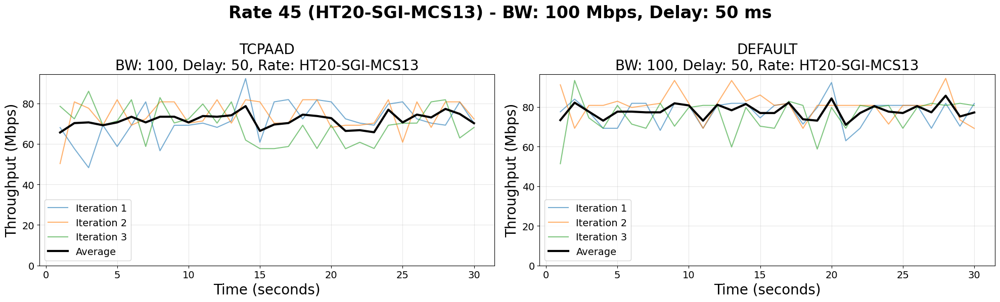

Rate 45, BW 100, Delay 100


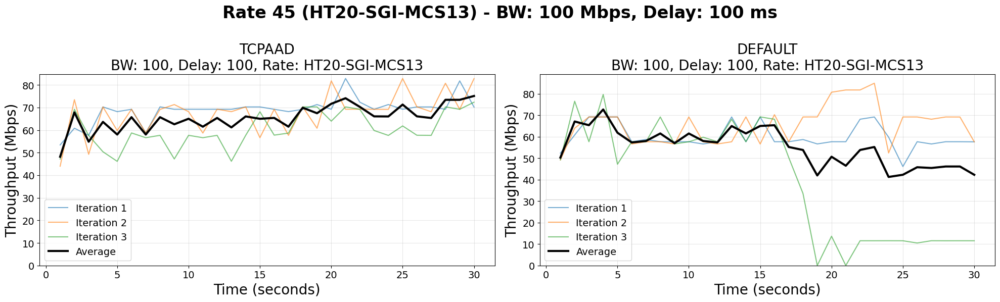

Rate 45, BW 100, Delay nodelay


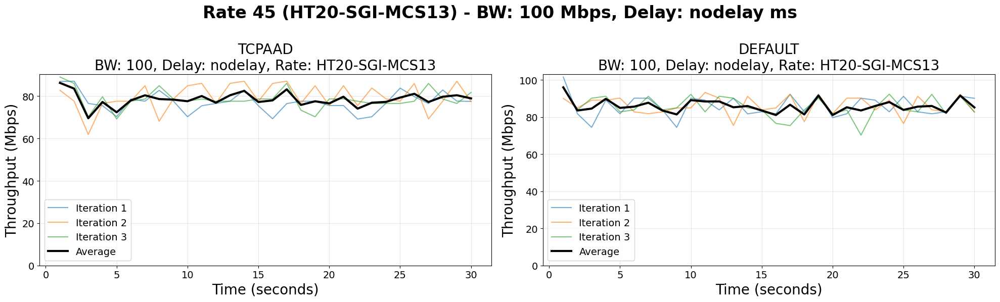

Rate 45, BW nolim, Delay 10


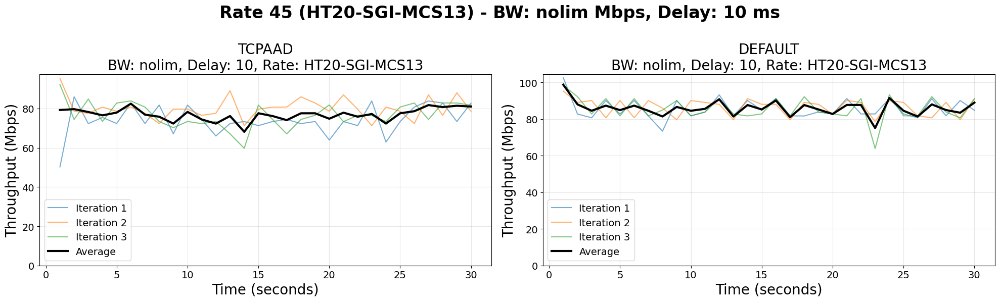

Rate 45, BW nolim, Delay 50


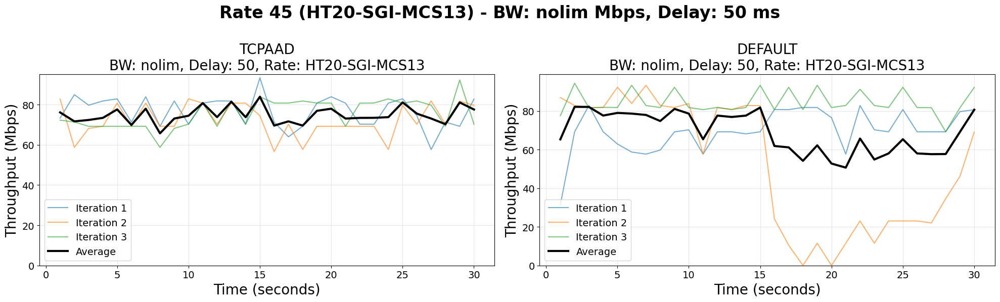

Rate 45, BW nolim, Delay 100


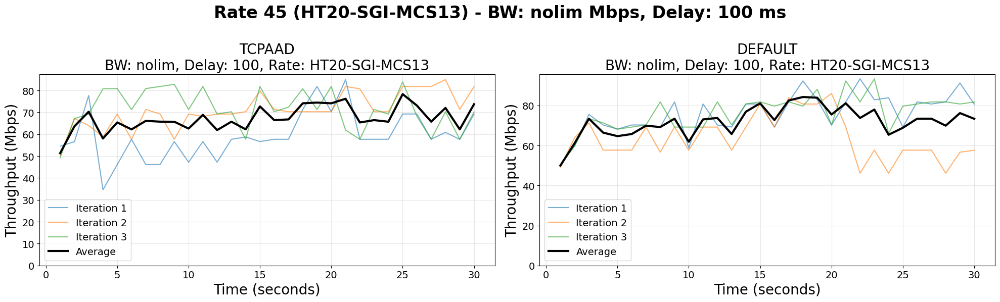

Rate 45, BW nolim, Delay nodelay


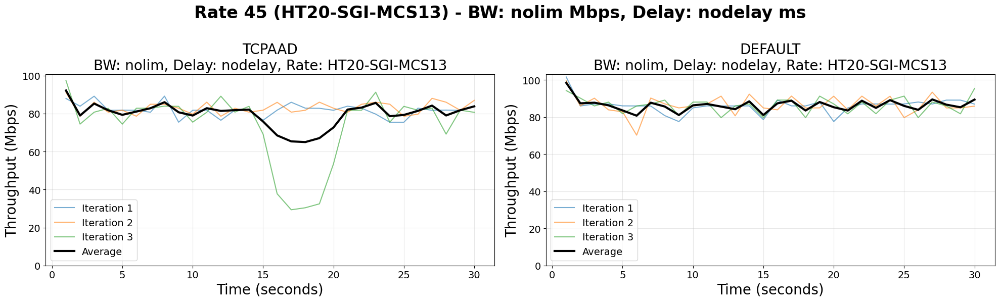

In [14]:
rate = 45
for bw in BANDWIDTHS:
    for delay in DELAYS:
        print(f"Rate {rate}, BW {bw}, Delay {delay}")
        plot_config_comparison(rate, bw, delay)

## Rate 44: HT20-SGI-MCS12

Rate 44, BW 20, Delay 10


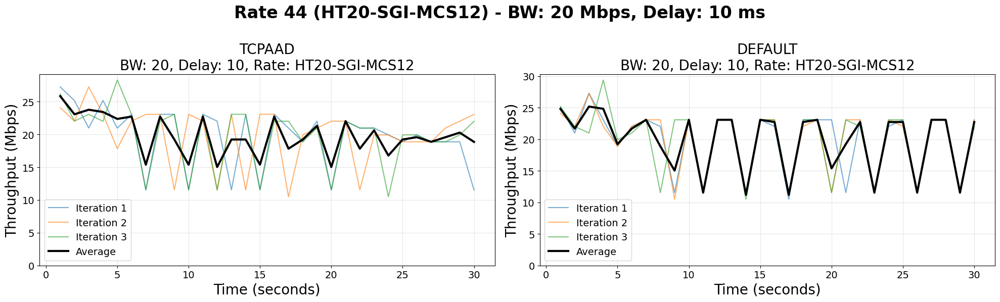

Rate 44, BW 20, Delay 50


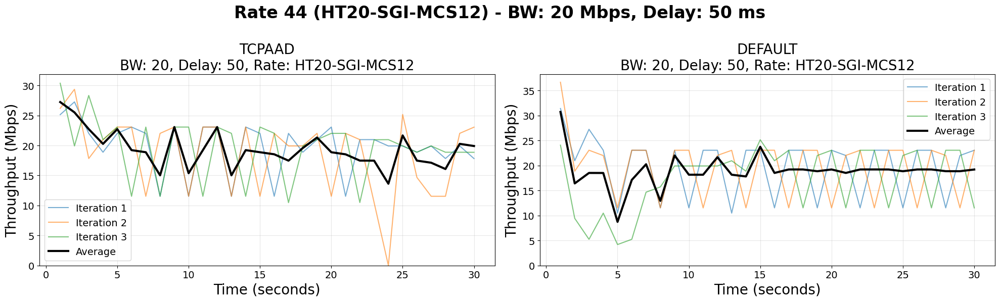

Rate 44, BW 20, Delay 100


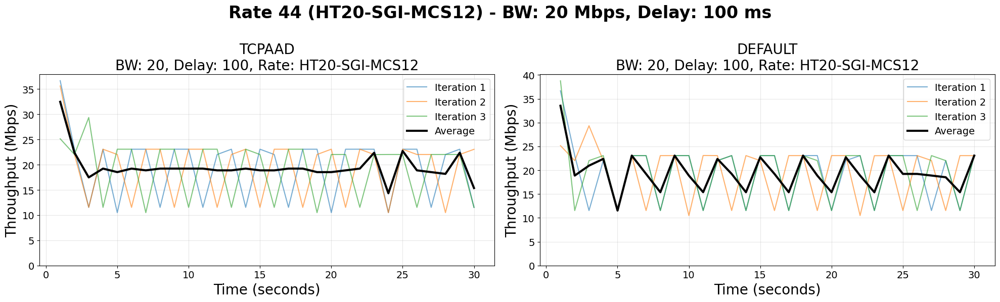

Rate 44, BW 20, Delay nodelay


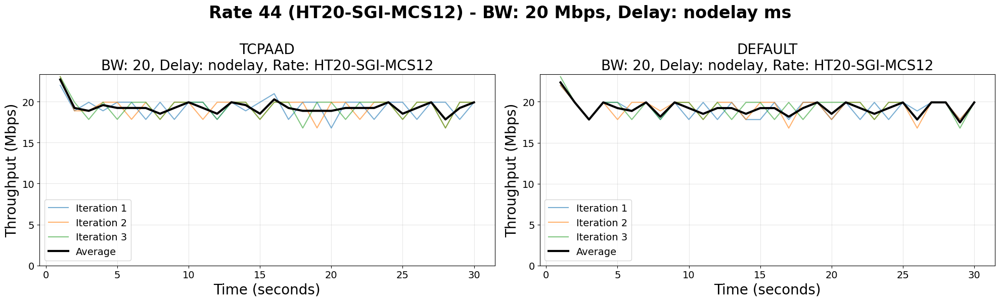

Rate 44, BW 50, Delay 10


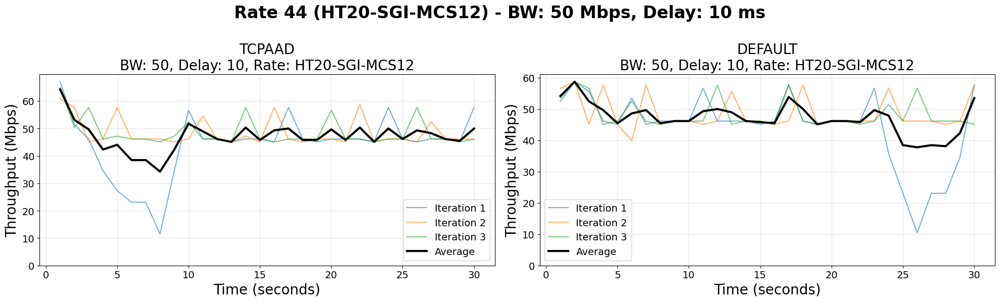

Rate 44, BW 50, Delay 50


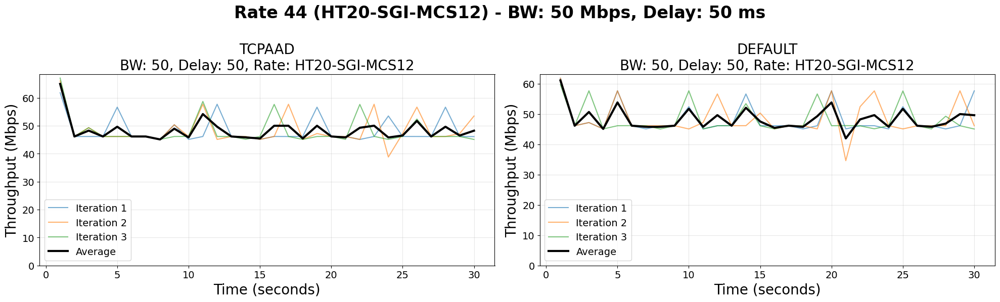

Rate 44, BW 50, Delay 100


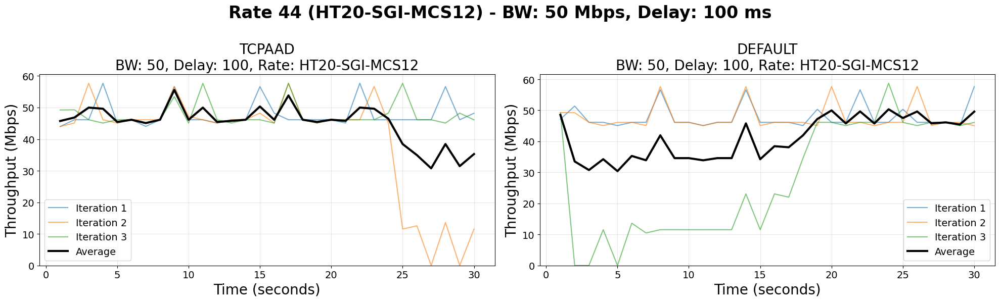

Rate 44, BW 50, Delay nodelay


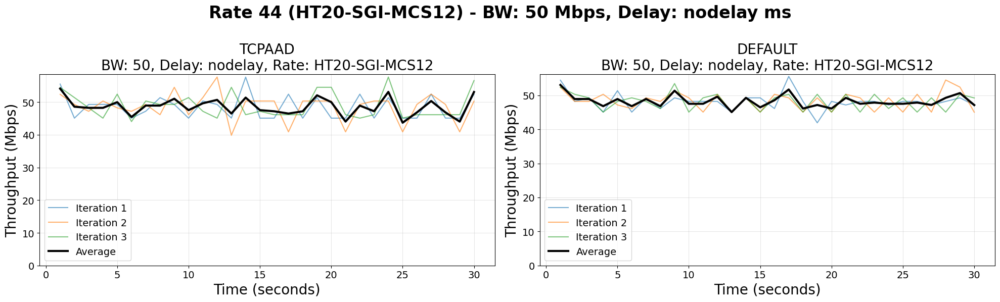

Rate 44, BW 100, Delay 10


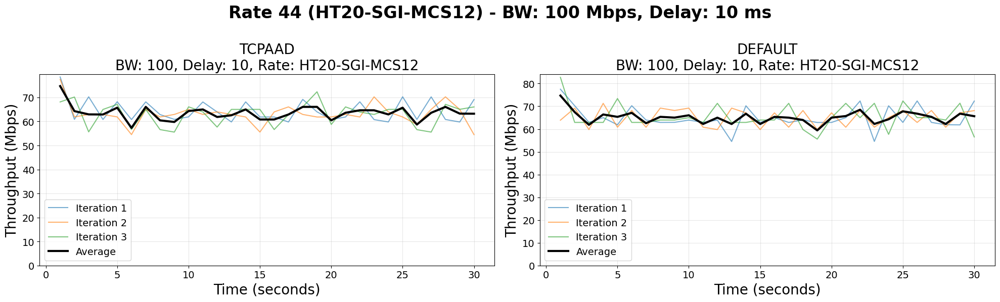

Rate 44, BW 100, Delay 50


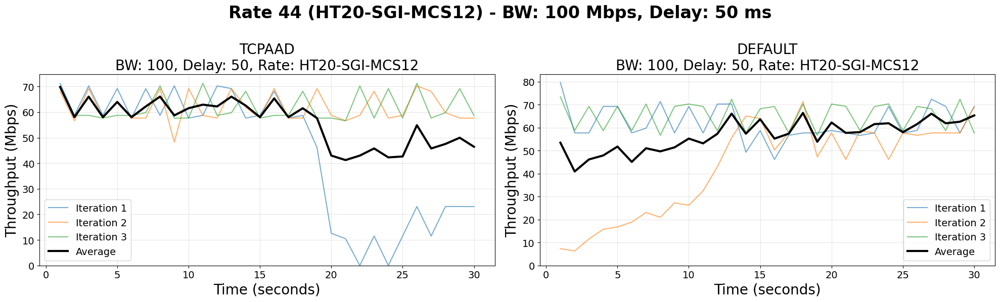

Rate 44, BW 100, Delay 100


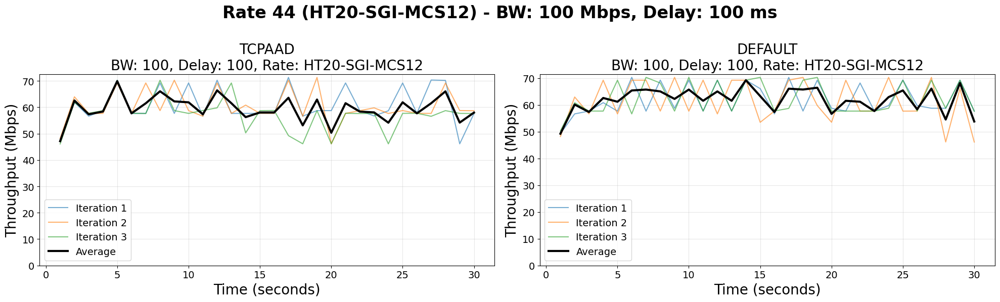

Rate 44, BW 100, Delay nodelay


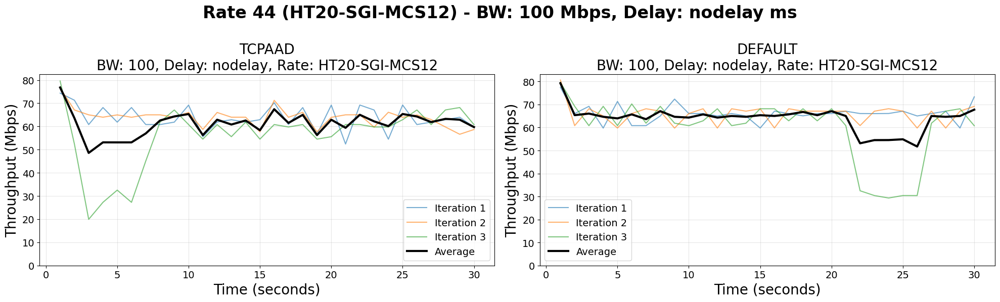

Rate 44, BW nolim, Delay 10


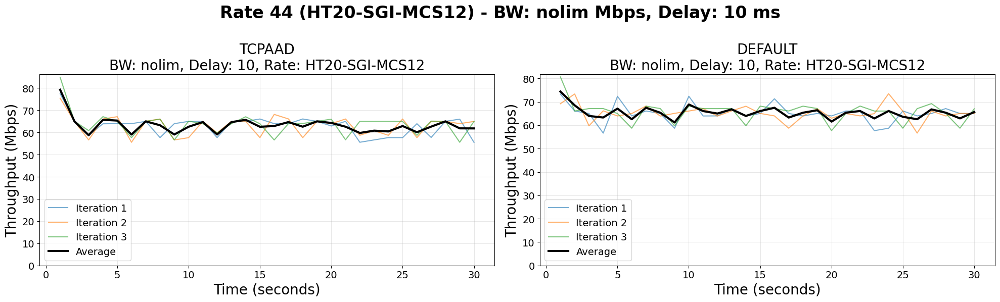

Rate 44, BW nolim, Delay 50


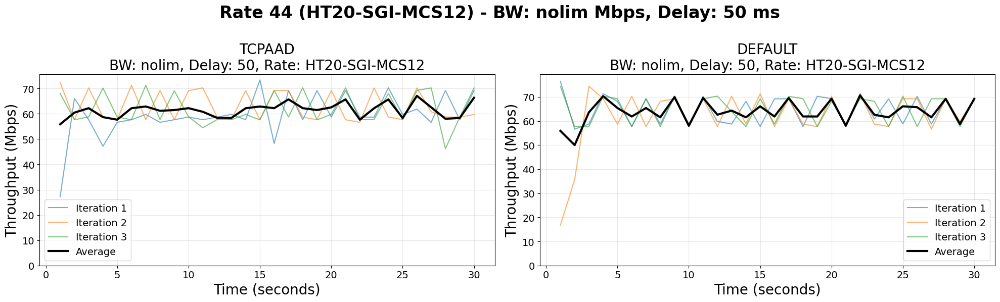

Rate 44, BW nolim, Delay 100


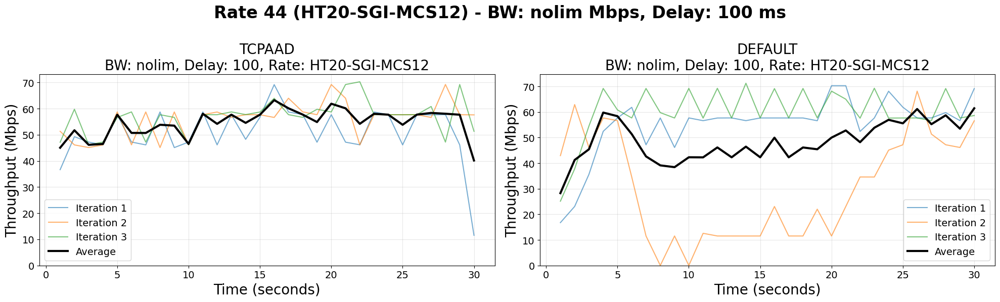

Rate 44, BW nolim, Delay nodelay


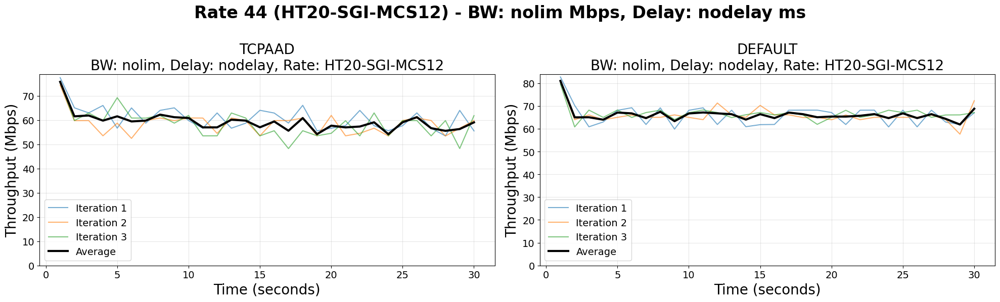

In [15]:
rate = 44
for bw in BANDWIDTHS:
    for delay in DELAYS:
        print(f"Rate {rate}, BW {bw}, Delay {delay}")
        plot_config_comparison(rate, bw, delay)

## Rate 36: HT20-SGI-MCS6

Rate 36, BW 20, Delay 10


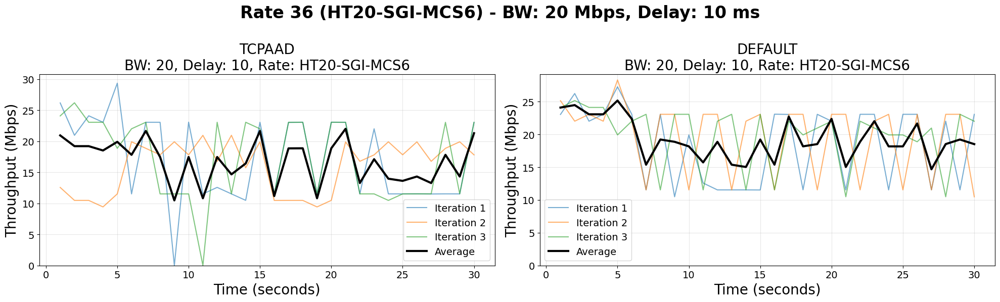

Rate 36, BW 20, Delay 50


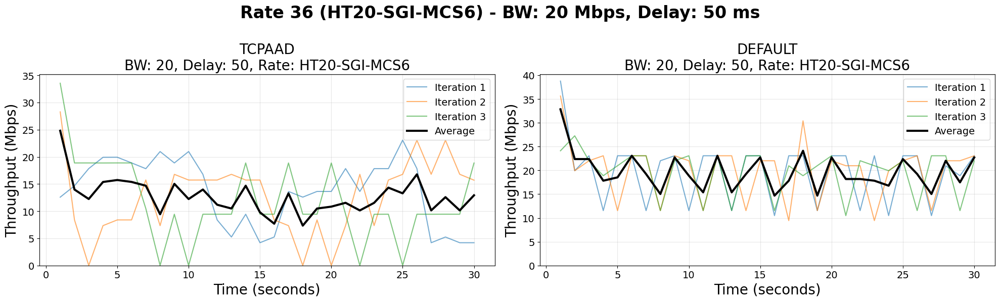

Rate 36, BW 20, Delay 100


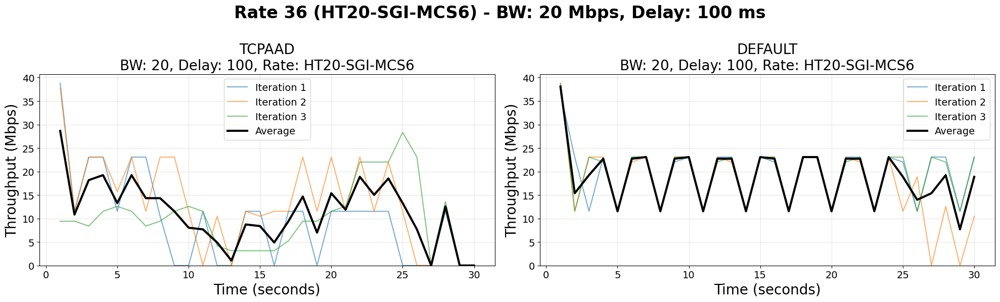

Rate 36, BW 20, Delay nodelay


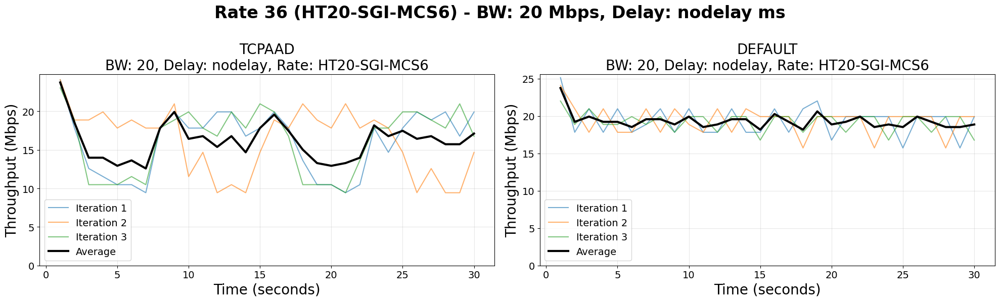

Rate 36, BW 50, Delay 10


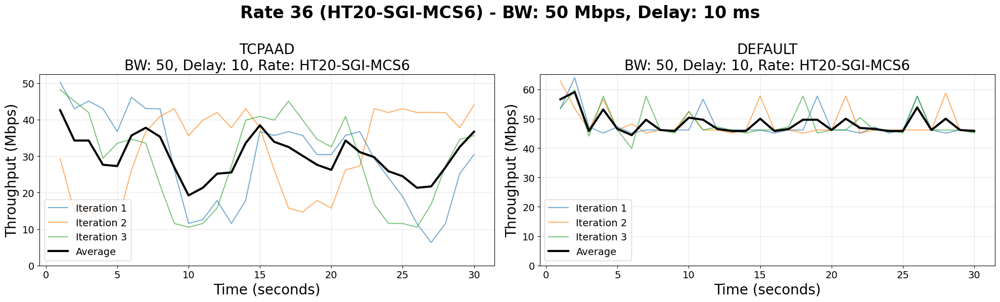

Rate 36, BW 50, Delay 50


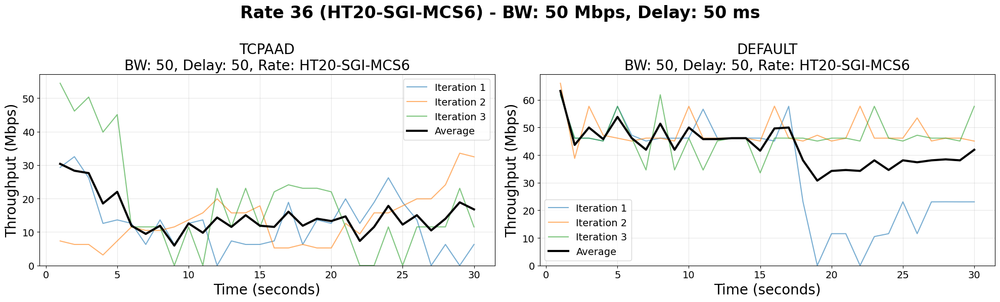

Rate 36, BW 50, Delay 100


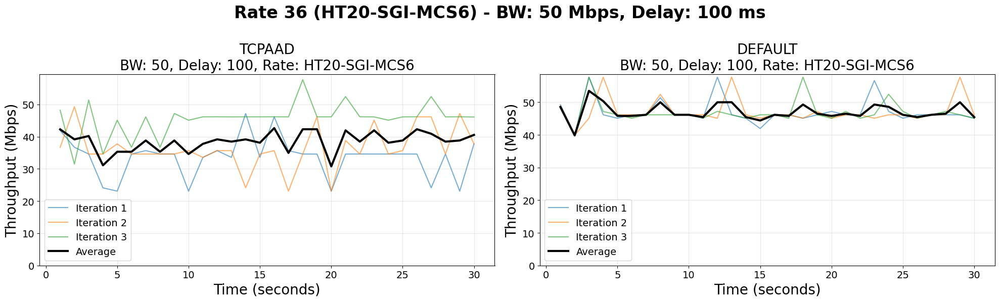

Rate 36, BW 50, Delay nodelay


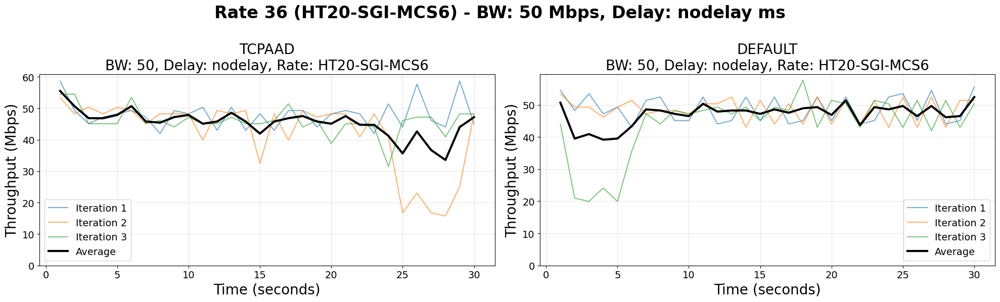

Rate 36, BW 100, Delay 10


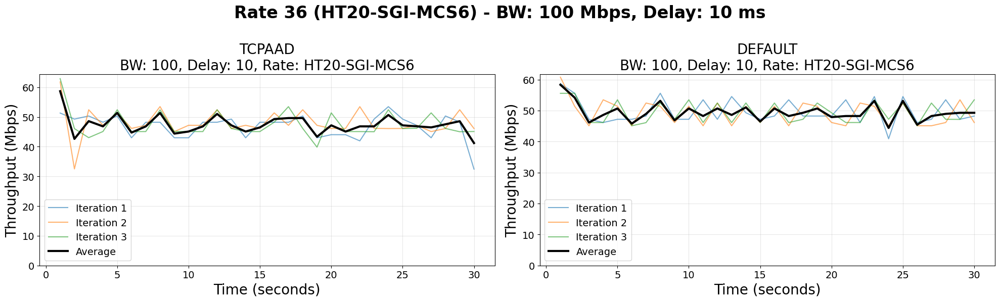

Rate 36, BW 100, Delay 50


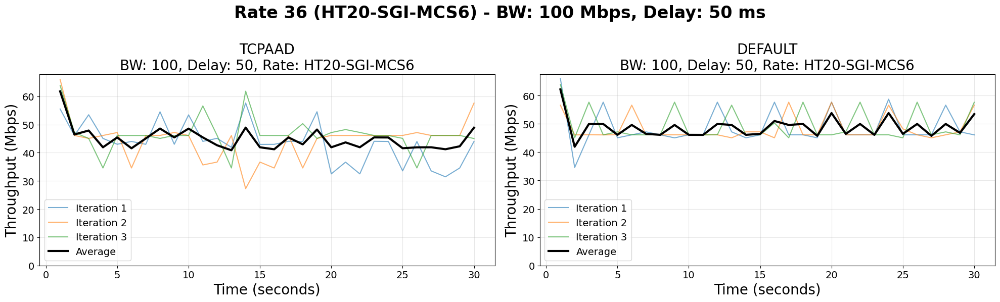

Rate 36, BW 100, Delay 100


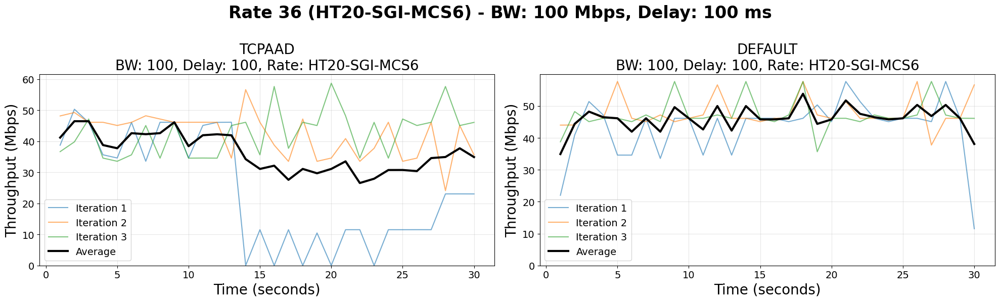

Rate 36, BW 100, Delay nodelay


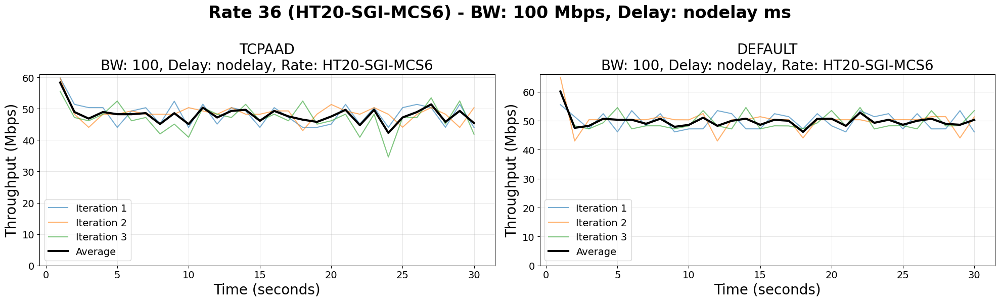

Rate 36, BW nolim, Delay 10


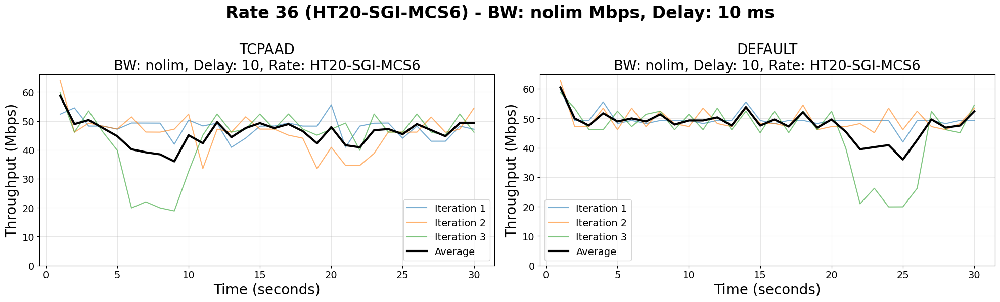

Rate 36, BW nolim, Delay 50


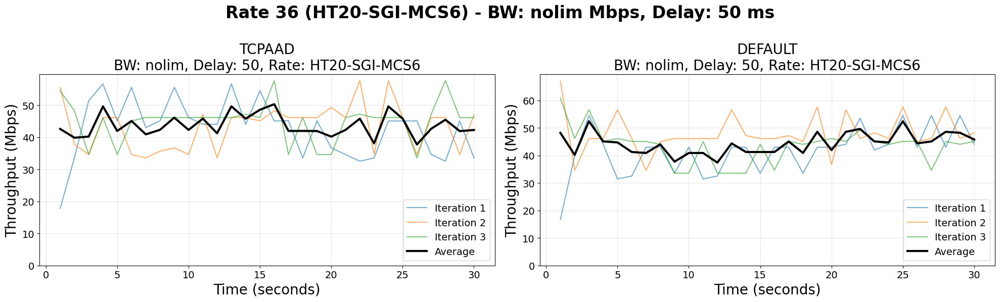

Rate 36, BW nolim, Delay 100


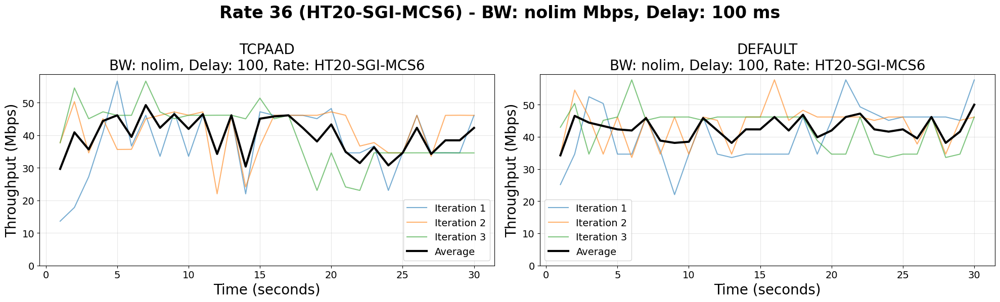

Rate 36, BW nolim, Delay nodelay


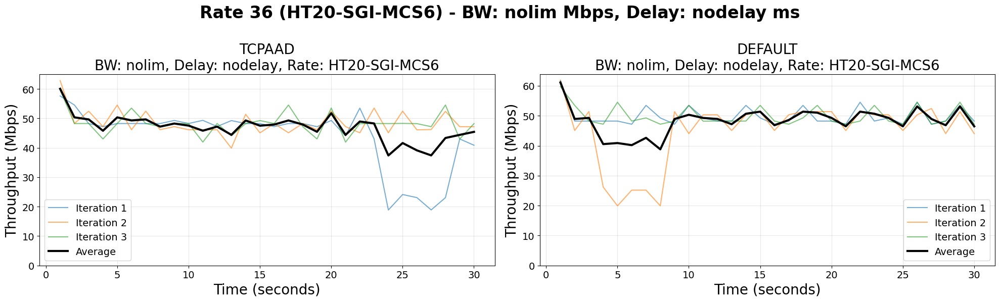

In [16]:
rate = 36
for bw in BANDWIDTHS:
    for delay in DELAYS:
        print(f"Rate {rate}, BW {bw}, Delay {delay}")
        plot_config_comparison(rate, bw, delay)

## Rate 35: HT20-SGI-MCS5

Rate 35, BW 20, Delay 10


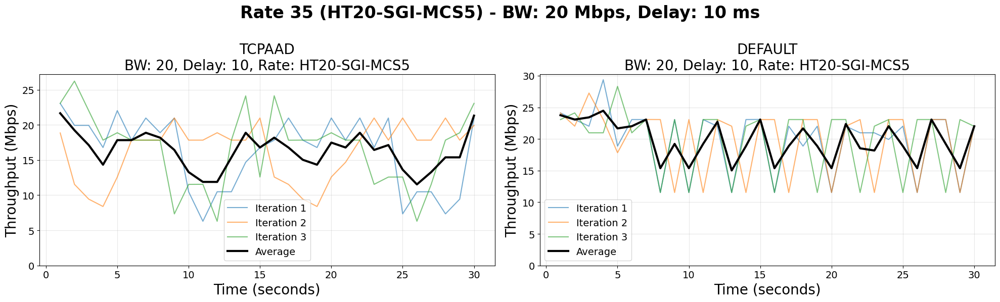

Rate 35, BW 20, Delay 50


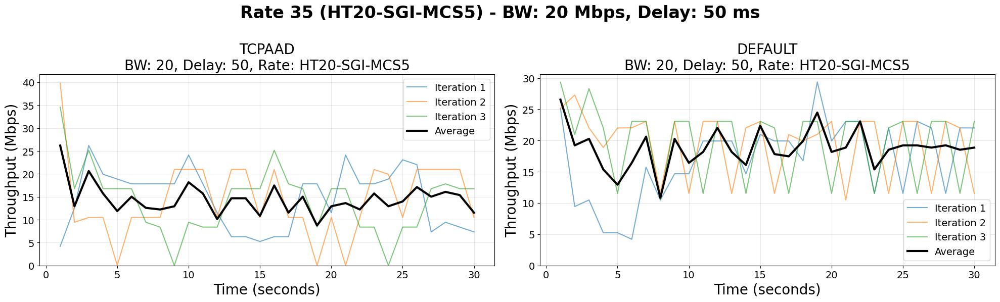

Rate 35, BW 20, Delay 100


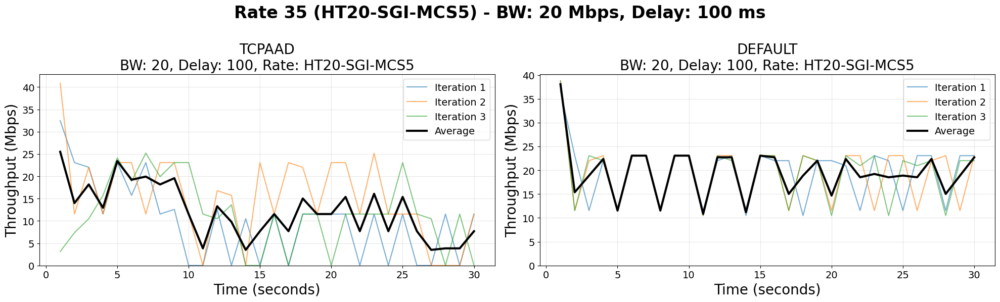

Rate 35, BW 20, Delay nodelay


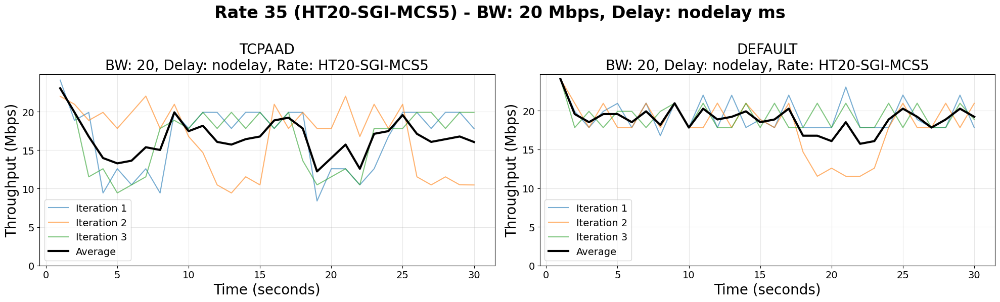

Rate 35, BW 50, Delay 10


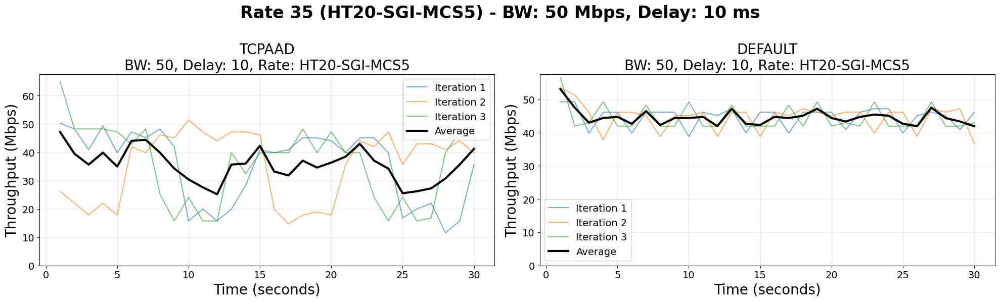

Rate 35, BW 50, Delay 50


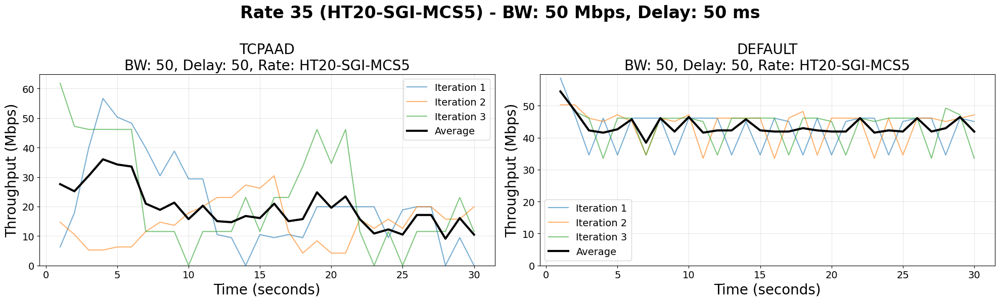

Rate 35, BW 50, Delay 100


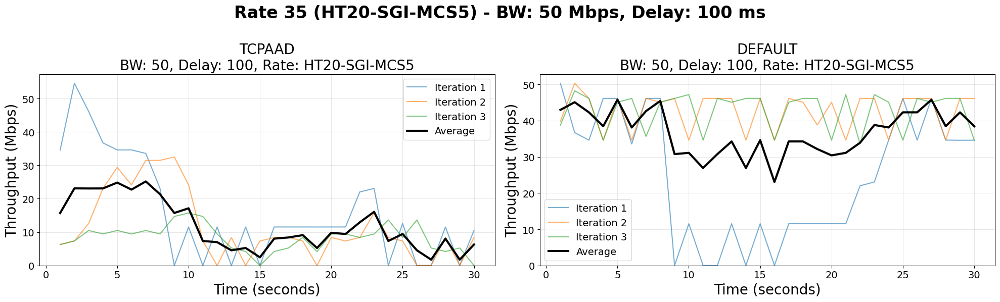

Rate 35, BW 50, Delay nodelay


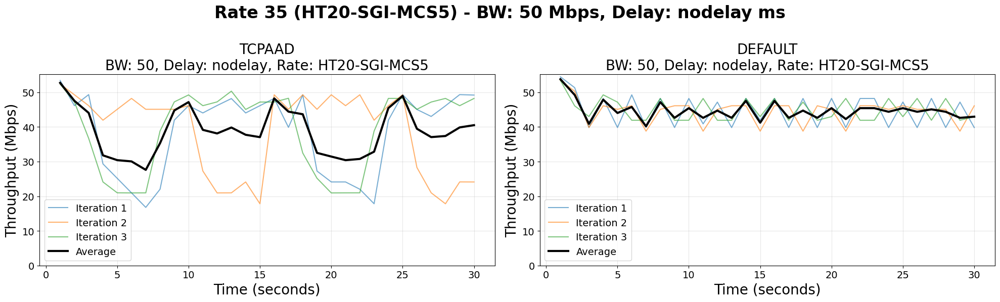

Rate 35, BW 100, Delay 10


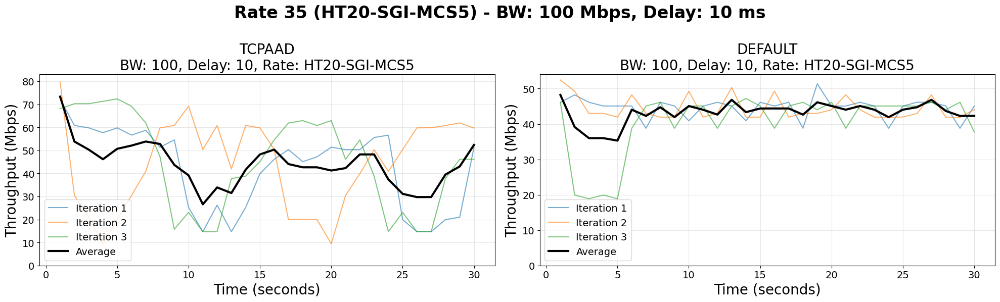

Rate 35, BW 100, Delay 50


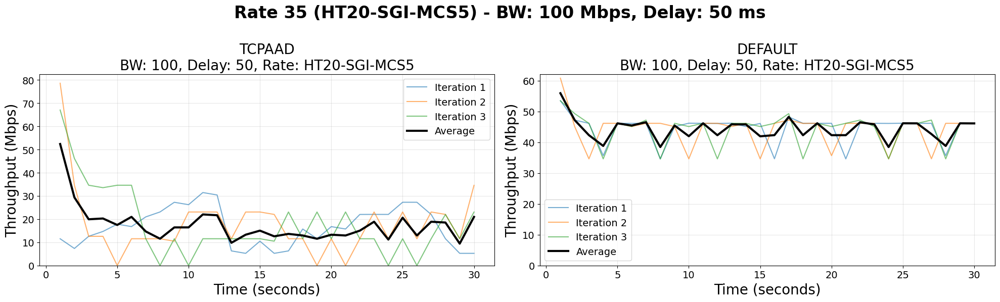

Rate 35, BW 100, Delay 100


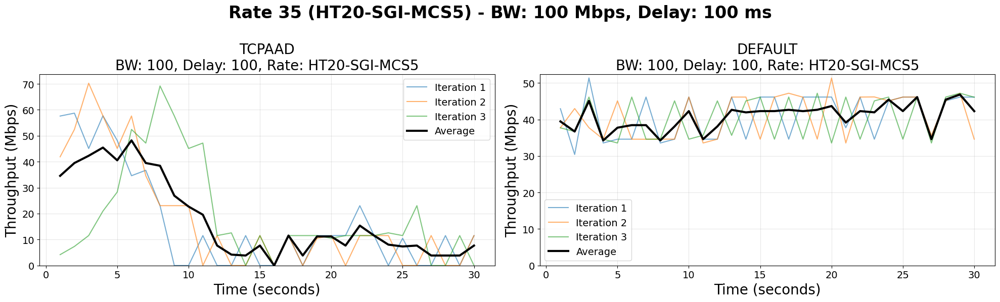

Rate 35, BW 100, Delay nodelay


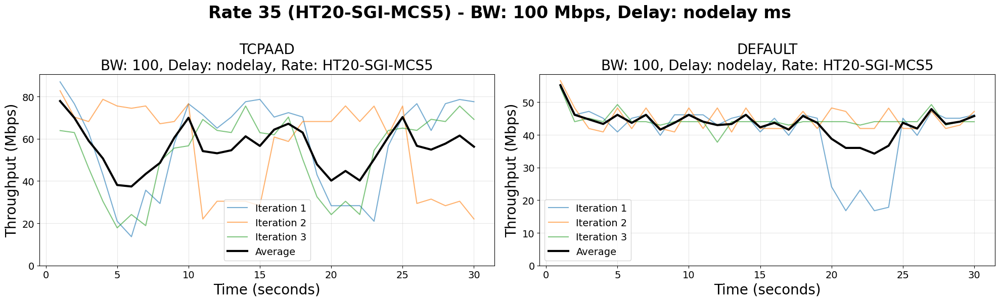

Rate 35, BW nolim, Delay 10


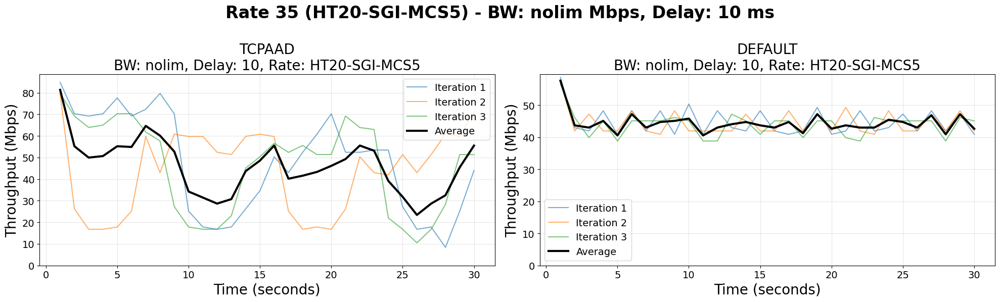

Rate 35, BW nolim, Delay 50


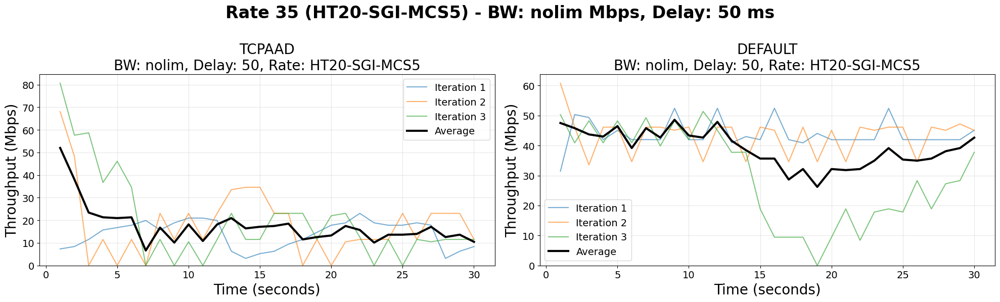

Rate 35, BW nolim, Delay 100


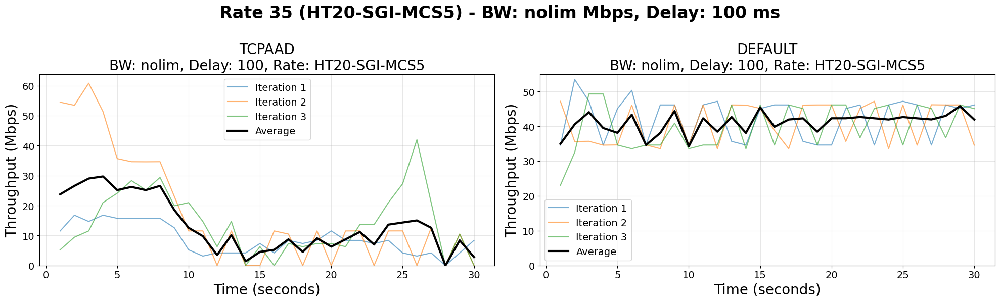

Rate 35, BW nolim, Delay nodelay


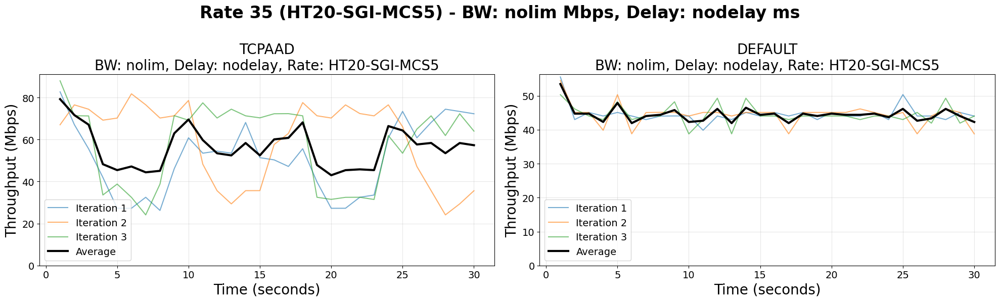

In [17]:
rate = 35
for bw in BANDWIDTHS:
    for delay in DELAYS:
        print(f"Rate {rate}, BW {bw}, Delay {delay}")
        plot_config_comparison(rate, bw, delay)

# Summary Statistics

Calculate overall performance metrics across all configurations:

In [20]:
# Calculate summary statistics
summary_data = []

for rate in RATES:
    for bw in BANDWIDTHS:
        for delay in DELAYS:
            # Load data for both kernels
            tcpaad_data = load_config_data('tcpaad', rate, bw, delay)
            default_data = load_config_data('default', rate, bw, delay)
            
            # Calculate averages
            _, tcpaad_avg = calculate_average(tcpaad_data)
            _, default_avg = calculate_average(default_data)
            
            # Calculate mean throughput
            tcpaad_mean = np.mean(tcpaad_avg) if tcpaad_avg is not None else None
            default_mean = np.mean(default_avg) if default_avg is not None else None
            
            # Calculate improvement percentage
            if tcpaad_mean is not None and default_mean is not None and default_mean > 0:
                improvement = ((tcpaad_mean - default_mean) / default_mean) * 100
            else:
                improvement = None
            
            summary_data.append({
                'Rate': rate,
                'Rate_Name': RATE_MAP[rate],
                'Bandwidth': bw,
                'Delay': delay,
                'TCP-AAD_Avg_Mbps': tcpaad_mean,
                'Default_Avg_Mbps': default_mean,
                'Improvement_%': improvement
            })

# Create DataFrame
summary_df = pd.DataFrame(summary_data)

# Display summary statistics
print("="*100)
print("SUMMARY STATISTICS")
print("="*100)
print(f"\nTotal configurations: {len(summary_df)}")
print(f"Configurations with TCP-AAD data: {summary_df['TCP-AAD_Avg_Mbps'].notna().sum()}")
print(f"Configurations with Default data: {summary_df['Default_Avg_Mbps'].notna().sum()}")
print(f"Configurations with both: {summary_df['Improvement_%'].notna().sum()}")

# Show top 10 improvements
if summary_df['Improvement_%'].notna().any():
    print("\n" + "="*100)
    print("TOP 10 IMPROVEMENTS (TCP-AAD vs Default)")
    print("="*100)
    top_improvements = summary_df.nlargest(10, 'Improvement_%')[
        ['Rate_Name', 'Bandwidth', 'Delay', 'TCP-AAD_Avg_Mbps', 'Default_Avg_Mbps', 'Improvement_%']
    ]
    print(top_improvements.to_string(index=False))
    
    # Show overall statistics
    print("\n" + "="*100)
    print("OVERALL IMPROVEMENT STATISTICS")
    print("="*100)
    valid_improvements = summary_df['Improvement_%'].dropna()
    if len(valid_improvements) > 0:
        print(f"Mean improvement: {valid_improvements.mean():.2f}%")
        print(f"Median improvement: {valid_improvements.median():.2f}%")
        print(f"Std deviation: {valid_improvements.std():.2f}%")
        print(f"Min improvement: {valid_improvements.min():.2f}%")
        print(f"Max improvement: {valid_improvements.max():.2f}%")
else:
    print("\nNo comparison data available yet. Run tests with both kernels to see improvements.")

# Save summary to CSV
summary_csv = PROJECT_ROOT / 'results' / 'summary_statistics.csv'
summary_df.to_csv(summary_csv, index=False)
print(f"\nSummary statistics saved to: {summary_csv}")

SUMMARY STATISTICS

Total configurations: 192
Configurations with TCP-AAD data: 192
Configurations with Default data: 192
Configurations with both: 192

TOP 10 IMPROVEMENTS (TCP-AAD vs Default)
     Rate_Name Bandwidth   Delay  TCP-AAD_Avg_Mbps  Default_Avg_Mbps  Improvement_%
 HT20-SGI-MCS4     nolim nodelay         60.287812         32.667472      84.549977
 HT20-SGI-MCS4       100 nodelay         60.020863         33.331677      80.071540
 HT20-SGI-MCS4     nolim      10         48.008997         31.491099      52.452597
 HT20-SGI-MCS4       100      10         45.585542         32.923976      38.456980
 HT20-SGI-MCS5       100 nodelay         55.687525         43.293230      28.628716
 HT20-SGI-MCS5     nolim nodelay         56.327307         44.505160      26.563544
 HT20-SGI-MCS4        50 nodelay         38.922595         32.621362      19.316280
HT20-SGI-MCS13       100     100         65.521314         55.047615      19.026617
HT20-SGI-MCS12     nolim     100         54.592616

# Test with Specific Configuration

Before generating all 192 plots, you can test with a specific configuration:

Testing with Rate 104, BW 100, Delay 100


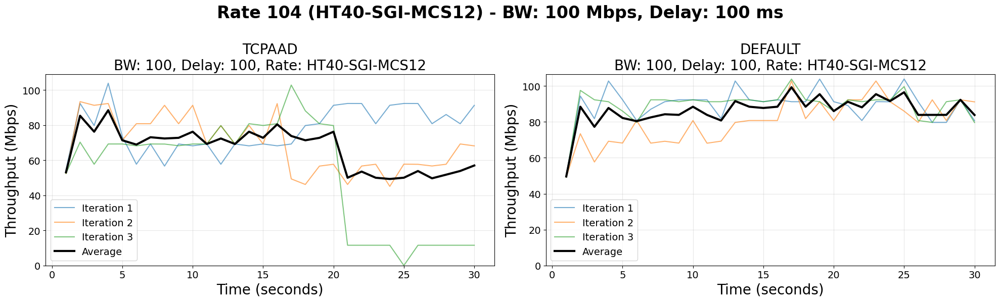

In [21]:
# Test with a single configuration
# Uncomment and modify to test with specific parameters

test_rate = 104
test_bw = '100'
test_delay = '100'

print(f"Testing with Rate {test_rate}, BW {test_bw}, Delay {test_delay}")
plot_config_comparison(test_rate, test_bw, test_delay)